In [329]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import scipy
import warnings
import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from matplotlib.pyplot import cm


%matplotlib inline

sns.set_style("darkgrid", {"grid.color": ".6", "grid.linestyle": ":"})
pd.set_option('max_rows', 50)

In [330]:
BOUNDARIES = [0, 1000, 10000, 50000, 100000, 200000, 500000, 1000000, 10000000, 1000000000]
N_RANGES = len(BOUNDARIES) - 1
MIN_SAMPLES = 40
POOLS = [
    ('WBTC', 'DAI', 1), # X_name / Y_name / tablecoin_index
    ('WBTC', 'USDC', 1),
    ('mAAPL', 'UST', 0),
    ('mBABA', 'UST', 1),
    ('mAMZN', 'UST', 1),
    ('uSTONKS_APR21', 'USDC', 0),
    ('AXE', 'DAI', 1),
    ('BUSD', 'USDC', 1),
    ('Coval', 'USDC', 1),
    ('HDAO', 'USDT', 1),
    ('HEX', 'USDT', 1),
    ('MATIC', 'USDT', 1),
    ('MOF', 'USDT', 1),
    ('SHIB', 'USDT', 1),
    ('TRADE', 'USDT', 1), 
    ('UNI', 'USDC', 1),
    ('RFOX', 'USDC', 0),
    ('SG', 'USDT', 0),
    ('WBTC', 'USDT', 1),
    ('ARMOR', 'DAI', 1), 
    ('CPRX', 'USDT', 1),
    ('CREDI', 'USDT', 1),
    ('DDX', 'USDC', 1),
    ('IOEN', 'USDT', 1),
    ('KOL', 'USDT', 1), 
    ('MUSK', 'USDT', 1),
    ('PRO', 'USDT', 1),
    ('PULSE', 'USDT', 1),
    ('MCO2', 'USDC', 0), 
    ('AGIX', 'USDT', 1),
    ('AKRO', 'USDC', 1),
    ('ALBT', 'USDT', 1),
    ('BDT', 'USDT', 1),
    ('BOND', 'USDC', 1),
    ('BRKL', 'USDC', 1),
    ('CLS', 'USDC', 1),
    ('DAI', 'USDC', 1),
    ('DAI', 'USDT', 1),
    ('DAO', 'USDC', 1),
    ('DERC', 'USDC', 1),
    ('DNXC', 'USDC', 1),
    ('DOGE', 'USDT', 1),
    ('eXRD', 'USDC', 1),
    ('FEAR', 'USDT', 1),
    ('FLX', 'USDC', 1),
    ('GAME', 'USDT', 1),
    ('GRO', 'USDC', 1),
    ('GUILD', 'USDC', 1),
    ('HEX', 'USDC', 1),
    ('INSUR', 'USDC', 1),
    ('LUNA', 'USDT', 1),
    ('MASK', 'USDC', 1),
    ('MIR', 'UST', 1),
    ('MPL', 'USDC', 1),
    ('NFTD', 'USDT', 1),
    ('NGL', 'USDC', 1),
    ('NUM', 'USDC', 1),
    ('OIL', 'USDC', 1),
    ('OPUL', 'USDC', 1),
    ('pBTC35A', 'USDT', 1),
    ('pETH18C', 'USDT', 1),
    ('PROS', 'USDC', 1),
    ('RACA', 'USDT', 1),
    ('RAD', 'USDC', 1),
    ('RPG', 'USDT', 1),
    ('SDAO', 'USDT', 1),
    ('SNP', 'USDC', 1),
    ('SNP', 'USDT', 1),
    ('SPOOL', 'DAI', 1),
    ('USDC', 'USDT', 1),
    ('VPAD', 'USDT', 1),
    ('WOO', 'USDC', 1),
    ('XCAD', 'USDT', 1),
    ('XFIT', 'USDT', 1),
]

In [331]:
def get_pool_index(x_name, y_name):
    for i in range(len(POOLS)):
        if POOLS[i][0] == x_name and POOLS[i][1] == y_name:
            return i

In [333]:
def filter_mev(swaps_df, X_NAME, Y_NAME):
    grouped = swaps_df.groupby('timestamp')
    l=None

    y_values = []
    txds = []

    for name, group in grouped:
        if len(group) <= 2:
            continue

        x_swaps = group[group.token_in == X_NAME]
        y_swaps = group[group.token_in == Y_NAME]


        for index, row in x_swaps.iterrows():
            if row['amount_out'] in y_swaps.amount_in.values:
                s = y_swaps[y_swaps.amount_in == row['amount_out']].iloc[0] # todo: assert length

                if row['amount_in'] < s['amount_out']:
                    y_values.append(s['amount_in'])
                    txds.append(s['txd'])
                    txds.append(row['txd'])



        for index, row in y_swaps.iterrows():
            if row['amount_out'] in x_swaps.amount_in.values:
                s = x_swaps[x_swaps.amount_in == row['amount_out']].iloc[0] # todo: assert length

                if row['amount_in'] < s['amount_out']:
                    y_values.append(row['amount_in'])
                    txds.append(s['txd'])
                    txds.append(row['txd'])  
                    
    filtered_swaps_df = swaps_df[~swaps_df.txd.isin(txds)]
    mevs_df = swaps_df[swaps_df.txd.isin(txds)]
    print(f'Initial swaps count: {len(swaps_df)}\nAfter filtering mevs: {len(filtered_swaps_df)}')
    
    return filtered_swaps_df, mevs_df

In [334]:
def filter_suspicious_transactions(swaps_df, X_NAME, Y_NAME):
    '''
    Filters transaction pairs initited by the same sender and executed in the same block, 
    where each transaction inside the pair is in a distinct direction and the percentage difference of in/out values is less than 5%
    
    Filtered transactions types: MEV transactions, Token extraction and subsequent return in consecutive transaction 
    (e.g.: for executing MEV attack on a pool with this token on some other platform)
    '''
    grouped = swaps_df.groupby(['timestamp', 'sender'])
    
    y_values = []
    txds = []
    
    for name, group in grouped:
        if len(group) != 2:
            continue
            
        s0 = group.iloc[0]
        s1 = group.iloc[1]
        
        if s0.token_in == s1.token_in:
            continue
            
        in0 = s0.amount_in
        in1 = s1.amount_in
        
        out0 = s0.amount_out
        out1 = s1.amount_out
        
        perc_diff0 = abs(out1 - in0) / ((out1 + in0) / 2) * 100
        perc_diff1 = abs(out0 - in1) / ((out0 + in1) / 2) * 100
        
        if perc_diff0 <= 5 or perc_diff1 <=5:
            txds.extend([s0.txd, s1.txd])
            
    filtered_swaps_df = swaps_df[~swaps_df.txd.isin(txds)]
    suspicious_df = swaps_df[swaps_df.txd.isin(txds)]

    print(f'After filtering sp: {len(filtered_swaps_df)}\n')


    return filtered_swaps_df, suspicious_df

In [335]:
from pprint import pprint

def count_mev_pairs(swaps_df, X_NAME, Y_NAME):
    grouped = swaps_df.groupby('timestamp')
    l=None

    y_values = []
    txds = []

    for name, group in grouped:
        if len(group) <= 2:
            continue

        x_swaps = group[group.token_in == X_NAME]
        y_swaps = group[group.token_in == Y_NAME]


        for index, row in x_swaps.iterrows():
            if row['amount_out'] in y_swaps.amount_in.values:
               # print(row)
                s = y_swaps[y_swaps.amount_in == row['amount_out']].iloc[0]

                if row['amount_in'] < s['amount_out']:
                    y_values.append(s['amount_in'])
                    txds.append(s['txd'])
                    txds.append(row['txd'])



        for index, row in y_swaps.iterrows():
            if row['amount_out'] in x_swaps.amount_in.values:
                s = x_swaps[x_swaps.amount_in == row['amount_out']].iloc[0]

                if row['amount_in'] < s['amount_out']:
                    y_values.append(row['amount_in'])
                    txds.append(s['txd'])
                    txds.append(row['txd'])  
                    
    return len(txds) // 2

## Load Data

In [337]:
import datetime

swaps = {}
removed_swaps = {}

idx = 0

for X_NAME, Y_NAME, stable_index in POOLS:    
    print(X_NAME, Y_NAME)

    swaps_df = pd.read_pickle(f'../data/pair_history/{X_NAME}_{Y_NAME}/{X_NAME}_{Y_NAME}_swaps.pkl')
    swaps_df = swaps_df[swaps_df.timestamp >= datetime.datetime(2020, 5, 1, 0, 0, 0)] # filter out period with law gas prices
    reserves_df = pd.read_pickle(f'../data/pair_history/{X_NAME}_{Y_NAME}/{X_NAME}_{Y_NAME}_reserves.pkl')

    reserves_df['reserve_stablecoin'] = reserves_df[f'reserve{stable_index}']
    reserves_df['reserve_stablecoin_prev'] = reserves_df[f'reserve{stable_index}'].shift(1)
    reserves_df['reserve_stablecoin_next'] = reserves_df[f'reserve{stable_index}'].shift(-1)
    reserves_df = reserves_df[(reserves_df['reserve_stablecoin_next'] - reserves_df['reserve_stablecoin']).abs()/((reserves_df['reserve_stablecoin_next'] + reserves_df['reserve_stablecoin'])/2) < 0.3]
    reserves_df = reserves_df[(reserves_df['reserve_stablecoin_prev'] - reserves_df['reserve_stablecoin']).abs()/((reserves_df['reserve_stablecoin_prev'] + reserves_df['reserve_stablecoin'])/2) < 0.3]

    
    merged_df = swaps_df.merge(reserves_df, left_on=[swaps_df.timestamp.dt.year, swaps_df.timestamp.dt.month, swaps_df.timestamp.dt.day], 
                                     right_on=[reserves_df.date.dt.year, reserves_df.date.dt.month, reserves_df.date.dt.day], how='inner')
    
    merged_df, removed1 = filter_mev(merged_df, X_NAME, Y_NAME)
   # merged_df, removed2 = filter_suspicious_transactions(merged_df, X_NAME, Y_NAME)
    
    swaps[idx] = merged_df
    
    removed1['type'] = 'MEV'
    removed2['type'] = 'SP'
    removed_swaps[idx] = pd.concat([removed1, removed2])
    
    idx += 1

WBTC DAI
Initial swaps count: 12016
After filtering mevs: 12000
WBTC USDC
Initial swaps count: 62637
After filtering mevs: 62493
mAAPL UST
Initial swaps count: 2051
After filtering mevs: 2031
mBABA UST
Initial swaps count: 1798
After filtering mevs: 1788
mAMZN UST
Initial swaps count: 1600
After filtering mevs: 1578
uSTONKS_APR21 USDC
Initial swaps count: 150
After filtering mevs: 150
AXE DAI
Initial swaps count: 527
After filtering mevs: 517
BUSD USDC
Initial swaps count: 15387
After filtering mevs: 15289
Coval USDC
Initial swaps count: 444
After filtering mevs: 442
HDAO USDT
Initial swaps count: 460
After filtering mevs: 450
HEX USDT
Initial swaps count: 5816
After filtering mevs: 5812
MATIC USDT
Initial swaps count: 2563
After filtering mevs: 2559
MOF USDT
Initial swaps count: 1698
After filtering mevs: 1670
SHIB USDT
Initial swaps count: 11417
After filtering mevs: 11405
TRADE USDT
Initial swaps count: 312
After filtering mevs: 306
UNI USDC
Initial swaps count: 16447
After filterin

In [280]:
def get_pools_count_in_range(a, b):
    cnt = 0
    for key, df in swaps.items():
        x_name, y_name, stable_index = POOLS[key]
        
        range_swaps_df = df[(df[f'reserve{stable_index}'] >= a) & (df[f'reserve{stable_index}'] < b)]
        range_swaps_y_df = range_swaps_df[range_swaps_df.token_in == y_name]
        amount_in_values = range_swaps_df[range_swaps_df.token_in == y_name].amount_in
        count = len(amount_in_values)

        if count >= MIN_SAMPLES:
            cnt += 1
            
    return cnt

#### Histograms for each reserve range

Range: [0 - 1000]
Range: [1000 - 10000]
Range: [10000 - 50000]
Range: [50000 - 100000]
Range: [100000 - 200000]
Range: [200000 - 500000]
Range: [500000 - 1000000]
Range: [1000000 - 10000000]
Range: [10000000 - 1000000000]


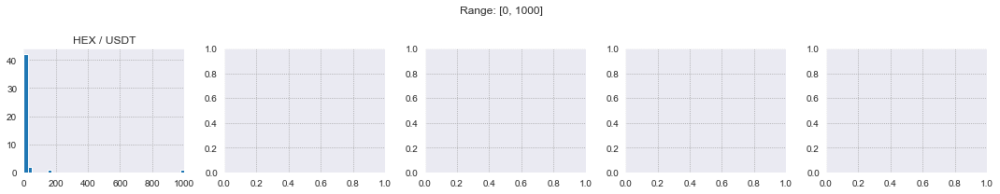

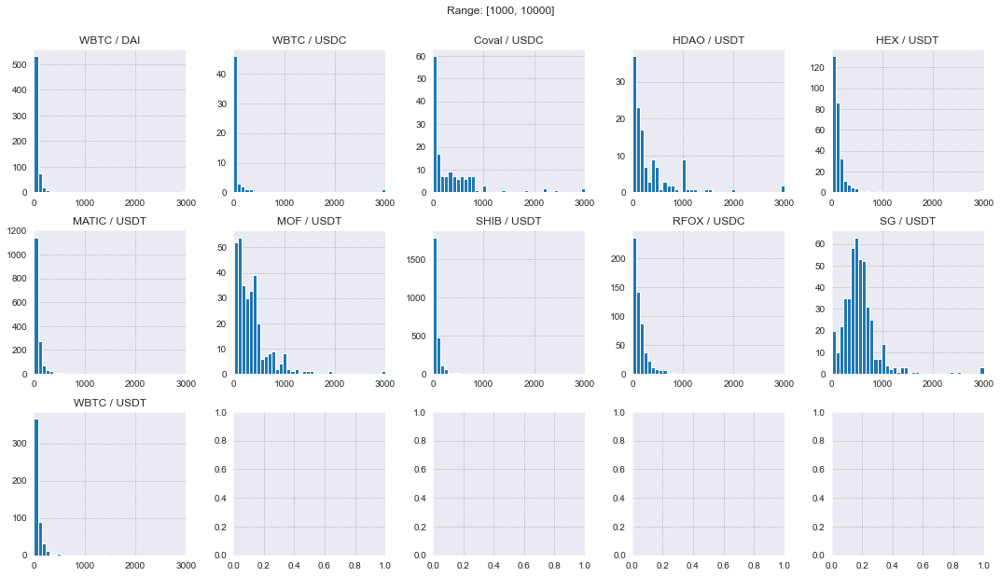

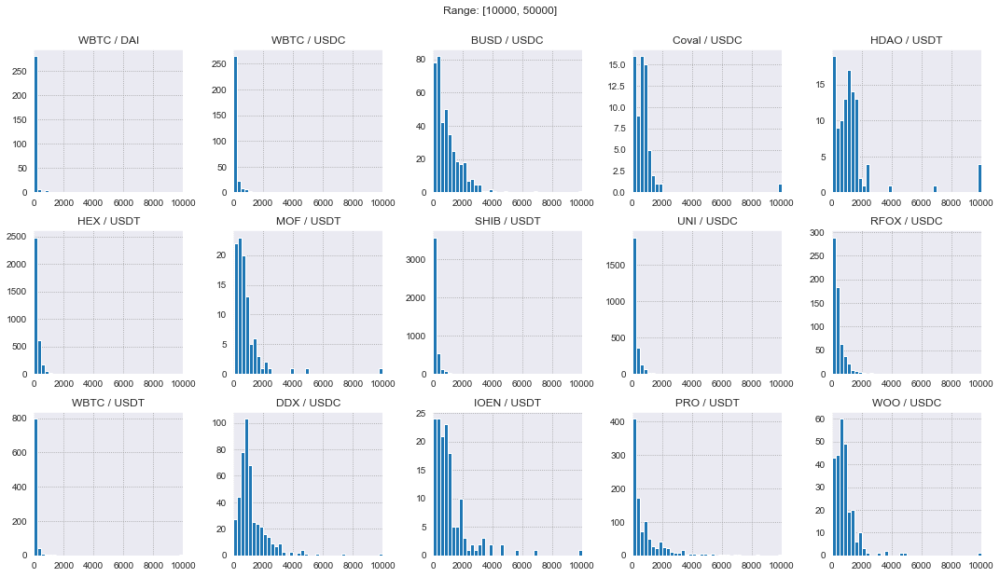

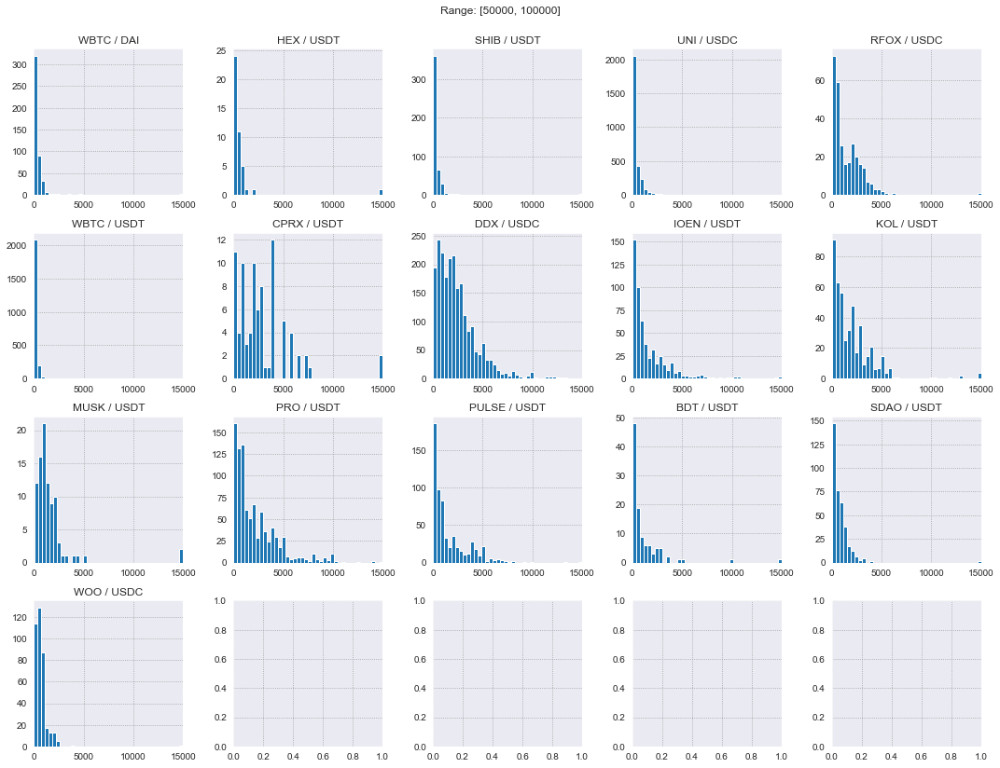

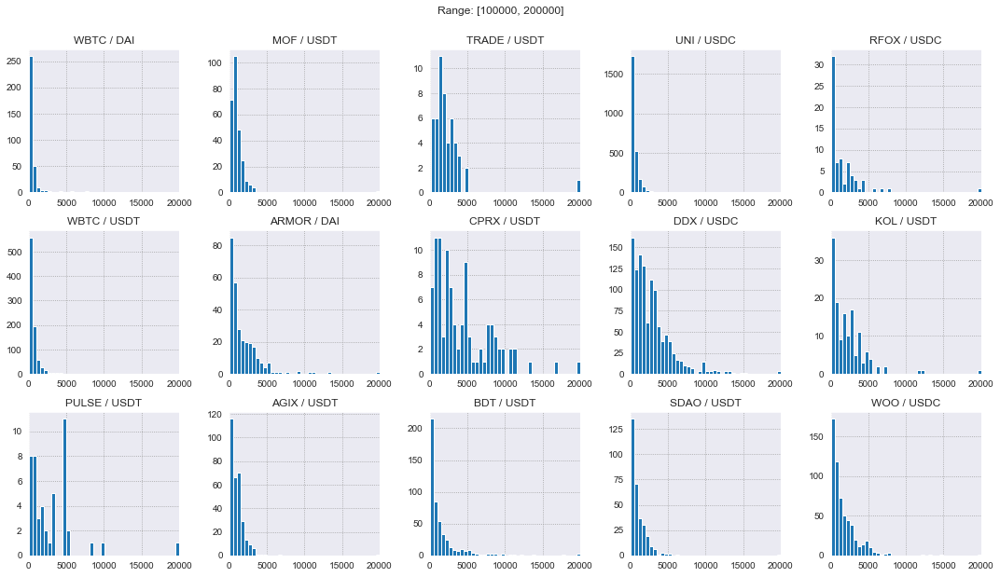

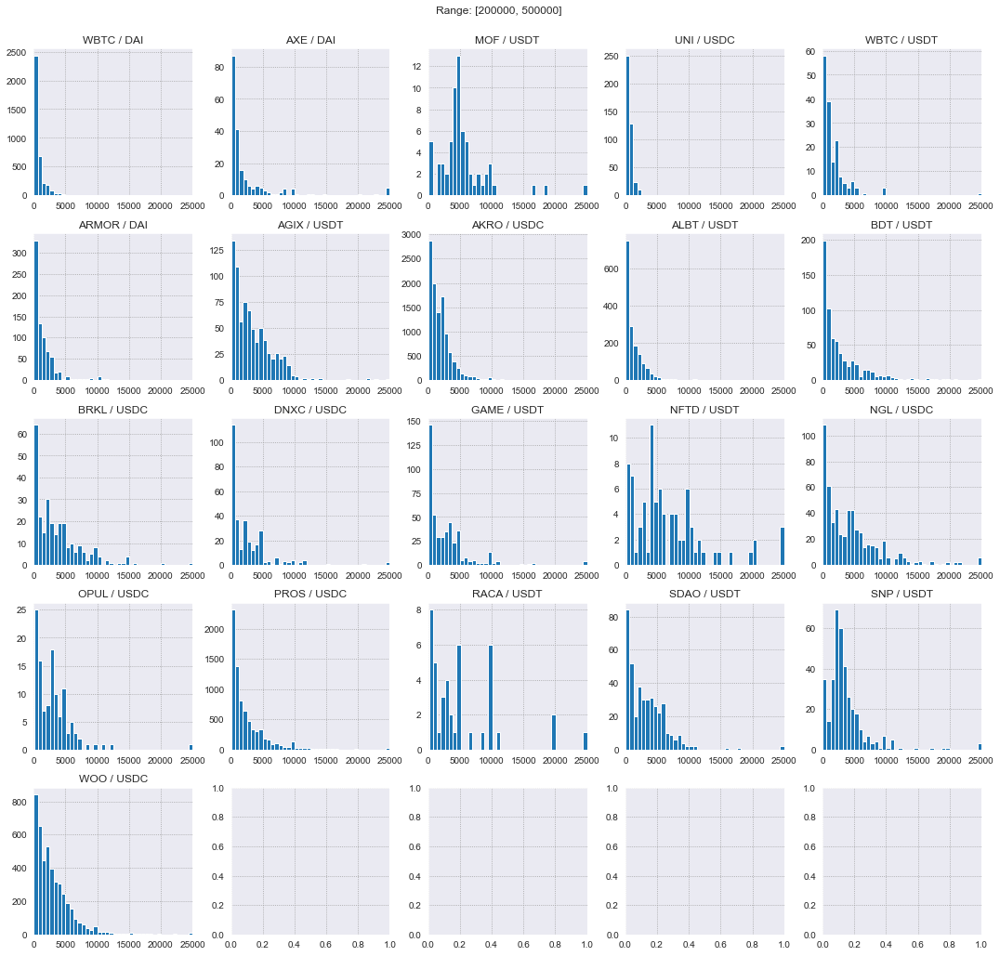

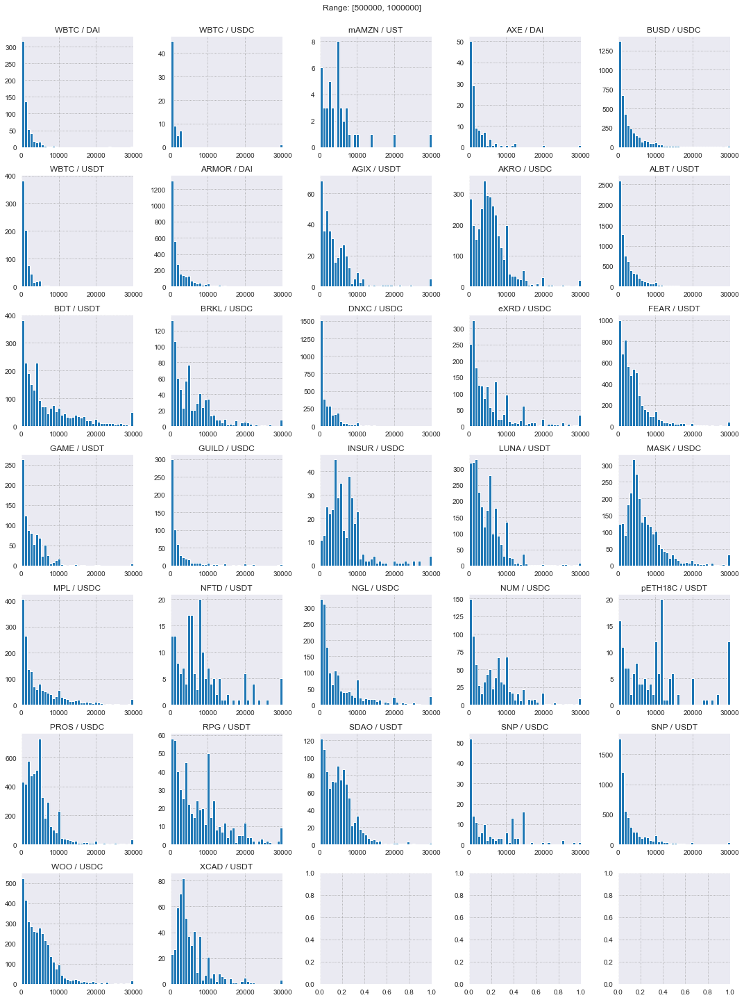

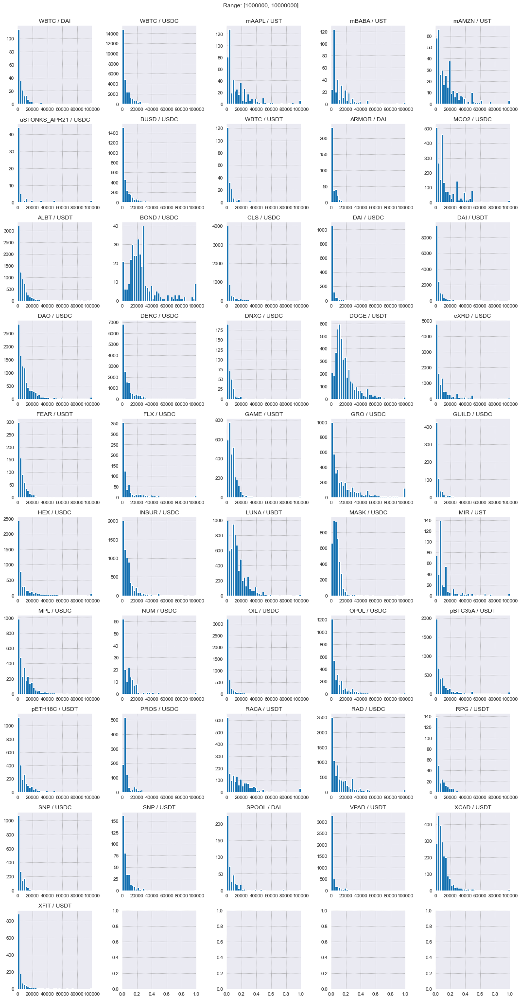

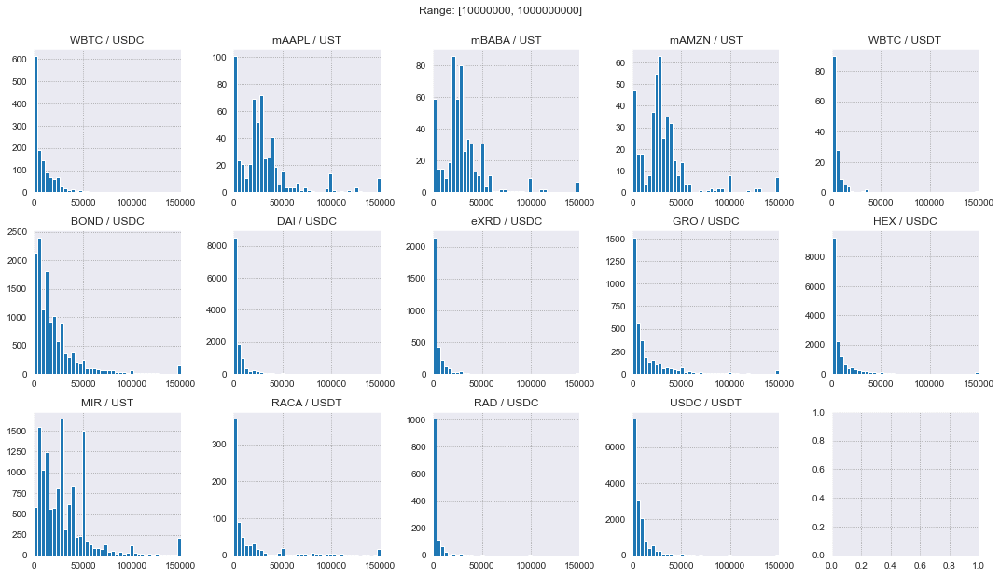

In [278]:
X_MAX_LIST = [1000, 3000, 10000, 15000, 20000, 25000, 30000, 100000, 150000]

reserve_i = 0
for a, b in zip(BOUNDARIES[:-1], BOUNDARIES[1:]):    
    print(f'Range: [{a} - {b}]')
    n_pools = get_pools_count_in_range(a, b)
    COLS = 5
    ROWS = n_pools//COLS + (n_pools % COLS != 0)

    fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*3, ROWS*3))
    ax = ax.ravel()
    
    X_MAX = X_MAX_LIST[reserve_i]
    
    i = 0
    for key, df in swaps.items():
        x_name, y_name, stable_index = POOLS[key]
        
        range_swaps_df = df[(df[f'reserve{stable_index}'] >= a) & (df[f'reserve{stable_index}'] < b)]
        range_swaps_y_df = range_swaps_df[range_swaps_df.token_in == y_name]
        amount_in_values = range_swaps_df[range_swaps_df.token_in == y_name].amount_in.values
        count = len(amount_in_values)        

        if count < MIN_SAMPLES:
            continue
            
        values = amount_in_values.copy()
        values[values > X_MAX] = X_MAX
        values = np.append(values, X_MAX)
        
        ax[i].hist(values, bins=40)
        ax[i].set_title(f'{x_name} / {y_name}')
        ax[i].set_xlim(0, X_MAX)
        i += 1

    fig.suptitle(f'Range: [{a}, {b}]') 
    fig.tight_layout(rect=[0, 0.03, 1, 0.98])
    reserve_i += 1
    


In [281]:
def compute_errors(amount_in_values, dist, fitted_params_cnt):
    if len(amount_in_values) < MIN_SAMPLES:
        mae=None
        sq_error=None
        AIC=None
    else:
        bin_width = 1000
        bins_count = max(20, int(max(amount_in_values) // bin_width))

        y, x = np.histogram(amount_in_values, bins=bins_count, density=True)
        x = [(this + x[i + 1]) / 2.0 for i, this in enumerate(x[0:-1])]

        pdf_fitted_bins = dist.pdf(x)

        pdf = dist.pdf(amount_in_values)

        sq_error = sum((pdf_fitted_bins - y) ** 2)
        mae = sum(abs(pdf_fitted_bins - y))
        logLik = np.sum(dist.logpdf(amount_in_values))

        k = fitted_params_cnt
        AIC = 2*k - 2*logLik

    return sq_error, mae, AIC

### Identification of best-fit trade size distribution
#### Compared distributions: Lognormal, Weibull, Gamma, HalfCauchy

In [360]:
def plot_pdf(dist, label, x_limit, ax):
    x = np.linspace(0, x_limit, 1000)
    y = dist.pdf(x)
    
    ax.plot(x, y, label=label)

In [388]:
df = swaps[18].copy()

,key_0,key_1,key_2,token_in,token_out,amount_in,amount_out,amount_usd,timestamp,sender,to,txd,reserve0,reserve1,reserveUSD,dailyVolumeToken0,dailyVolumeToken1,date,reserve_stablecoin,reserve_stablecoin_prev,reserve_stablecoin_next
6237,2021,4,4,USDT,WBTC,475,0.00816417,474.751,2021-04-04 23:40:20,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x69cda6eda9986f7fca8a5dba06c819b535f4fc50,0xa4620c55b0da2d7715a25c37425985cefacec610df25...,2.40451,139952,279702,0.20015557,11662.6,2021-04-04,139952,108034,140540
6238,2021,4,4,USDT,WBTC,194.767,0.00336366,194.62,2021-04-04 22:51:24,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x888759cb22cedadf2cfb0049b03309d45aa380d9,0x01791bfbd211d292faab5602f8906e573c4557734863...,2.40451,139952,279702,0.20015557,11662.6,2021-04-04,139952,108034,140540
6239,2021,4,4,USDT,WBTC,150,0.00259694,150.015,2021-04-04 22:48:03,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0xbb2b8038a1640196fbe3e38816f3e67cba72d940,0x64aa0b1439fb2a598d080f22aebf0032b9b89f0df8ef...,2.40451,139952,279702,0.20015557,11662.6,2021-04-04,139952,108034,140540
6240,2021,4,4,USDT,WBTC,124.851,0.0021658,124.964,2021-04-04 22:46:04,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x004375dff511095cc5a197a54140a24efef3a416,0xae3f00a89e170c0ac79f0c04cc7f430404e4a3de5cb2...,2.40451,139952,279702,0.20015557,11662.6,2021-04-04,139952,108034,140540
6242,2021,4,4,USDT,WBTC,214.212,0.00368348,213.606,2021-04-04 21:26:25,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x2a4e4aa60ea158d3f542a7424454bd7ece43f82a,0x616a80283e042fe60bccdff48928fd2c230e29ffa71d...,2.40451,139952,279702,0.20015557,11662.6,2021-04-04,139952,108034,140540
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11546,2020,9,11,USDT,WBTC,100.229,0.00973687,99.3958,2020-09-11 20:24:05,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x37f2fa639ebf4827ae21ca27ec69bbc24a09f926,0xb67104c104839c5b867ea455063f4861e33120472d65...,10.6222,111843,219904,0.2318558,2402.98,2020-09-11,111843,110700,111556
11548,2020,9,11,USDT,WBTC,11.2949,0.00109653,11.1527,2020-09-11 14:58:25,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x2a17a19c7039779aff8e1843bb5303ce2a6a4ed5,0xf9990b28b9031883fdc8b756816170ea67530f991d5b...,10.6222,111843,219904,0.2318558,2402.98,2020-09-11,111843,110700,111556
11549,2020,9,11,USDT,WBTC,72.8364,0.00707647,71.8531,2020-09-11 11:03:29,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x087cd25a3d58a8cc316303fabac1f89b079c20a8,0xe58c6cbf3472f07ffac5363fe614ac5c04e62a6e09e1...,10.6222,111843,219904,0.2318558,2402.98,2020-09-11,111843,110700,111556
11550,2020,9,11,USDT,WBTC,87.7383,0.00853667,86.828,2020-09-11 09:25:36,0x7a250d5630b4cf539739df2c5dacb4c659f2488d,0x77f24c30963145504176784bce46ea47efdefaac,0xa143ab28b3047f087e89d3678a5e30f313397421ce11...,10.6222,111843,219904,0.2318558,2402.98,2020-09-11,111843,110700,111556


Text(0.5, 0, 'amount_in')

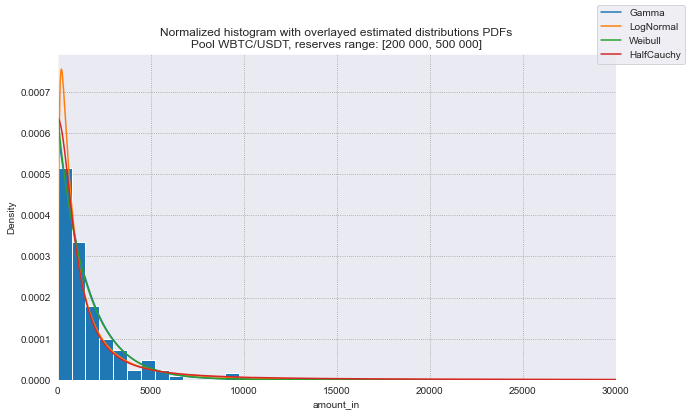

In [402]:
fig, ax = plt.subplots(figsize=(10, 6))
dist_list = [ scipy.stats.gamma, scipy.stats.lognorm, scipy.stats.weibull_min, scipy.stats.halfcauchy]
dist_names = ['Gamma', 'LogNormal', 'Weibull', 'HalfCauchy']
for i, dist in enumerate(dist_list):
    values = df[(df.reserve_stablecoin >= 200000) & (df.reserve_stablecoin <= 500000) & (df.token_in == 'USDT')].amount_in.values
    fitted_params = dist.fit(values, method='mle', floc=0)

    plot_pdf(dist(*fitted_params), dist_names[i], 30000, ax)
    sns.histplot(data=values, bins=40, stat='density', binrange=(0, 30000))
    
    ax.set_xlim(0, 30000)
    
fig.legend()
ax.set_title('Normalized histogram with overlayed estimated distributions PDFs\nPool WBTC/USDT, reserves range: [200 000, 500 000]')
ax.set_xlabel('amount_in')

Range: [0 - 1000]
Range: [1000 - 10000]
Range: [10000 - 50000]
Range: [50000 - 100000]
Range: [100000 - 200000]
Range: [200000 - 500000]
Range: [500000 - 1000000]
Range: [1000000 - 10000000]
Range: [10000000 - 1000000000]


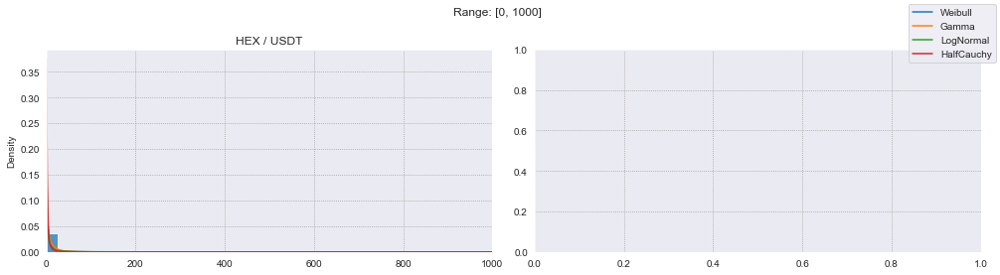

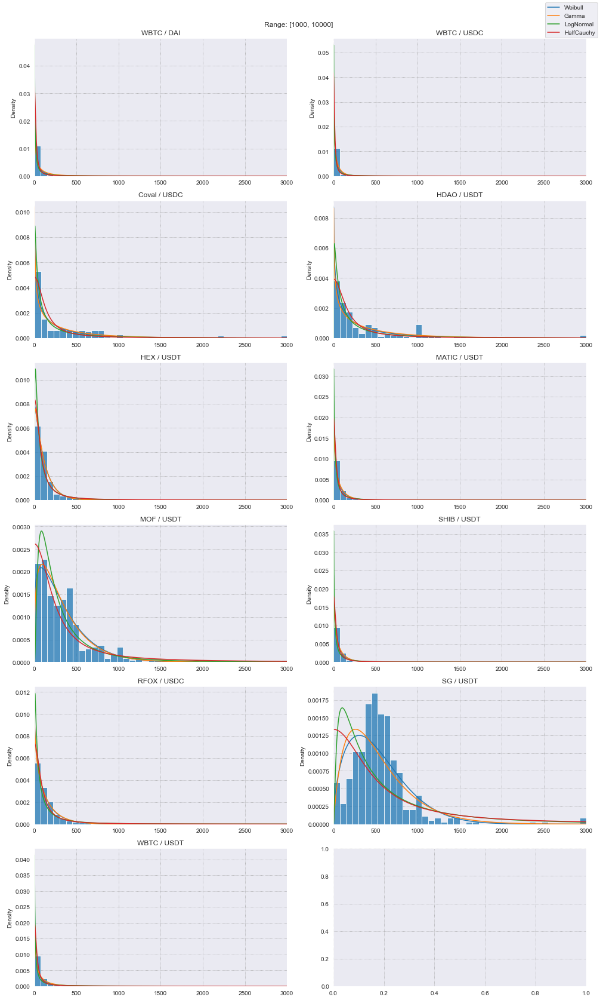

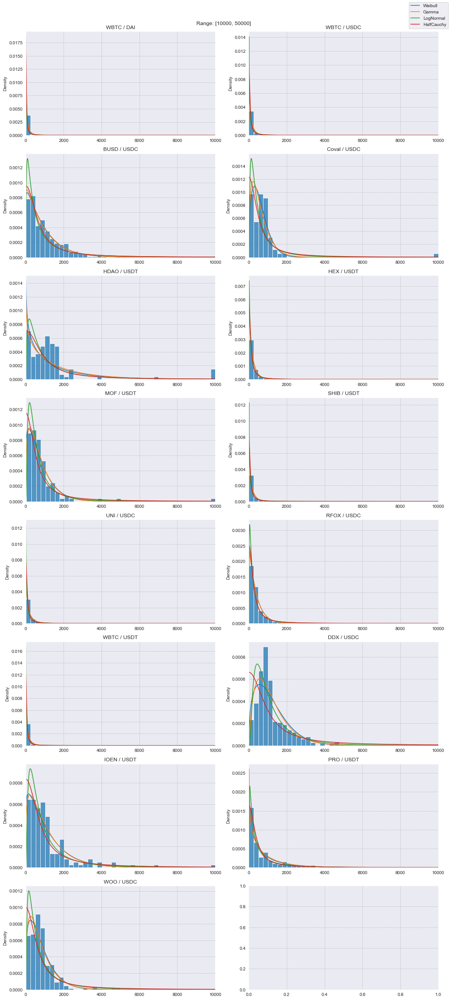

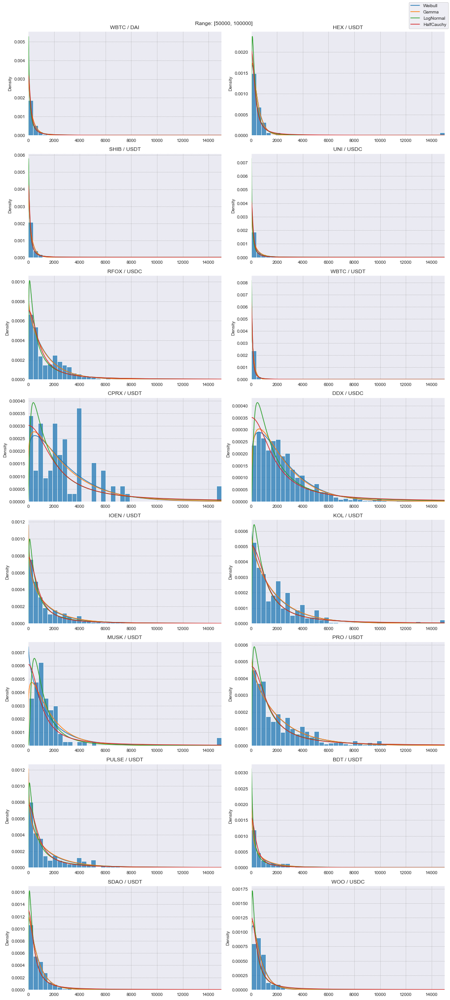

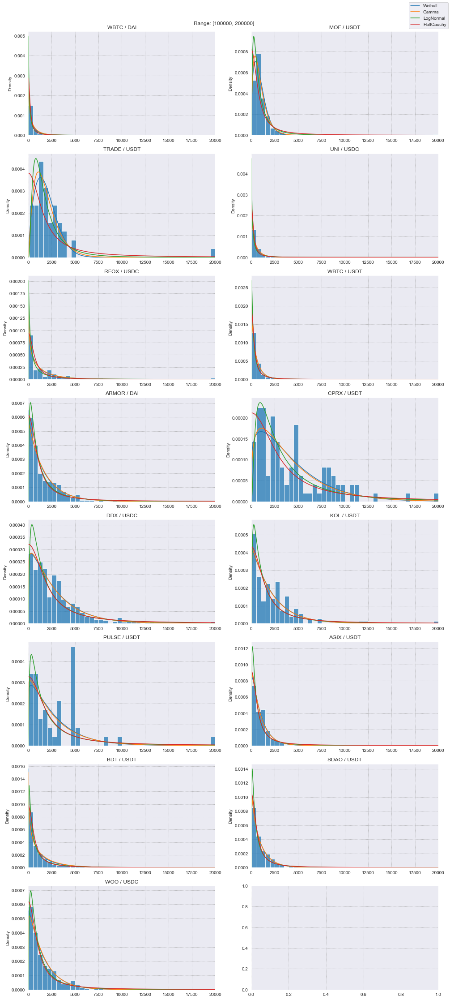

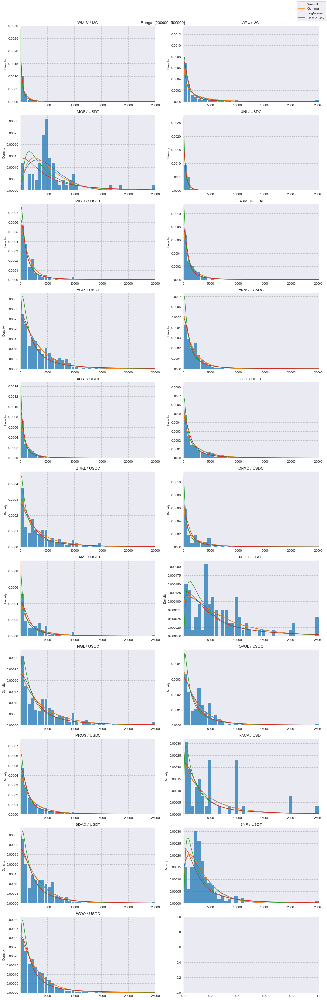

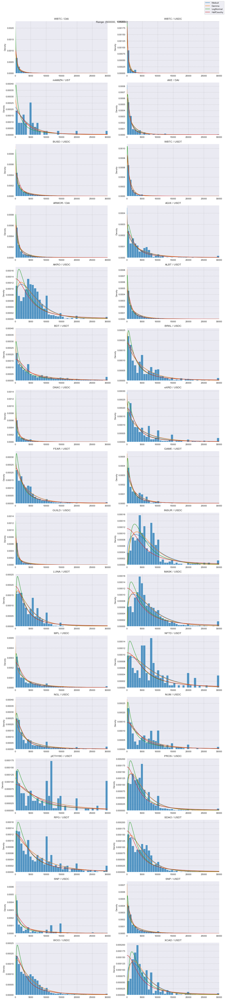

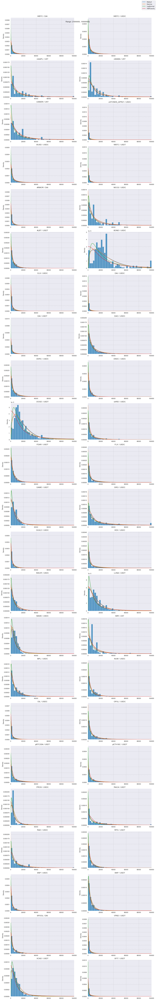

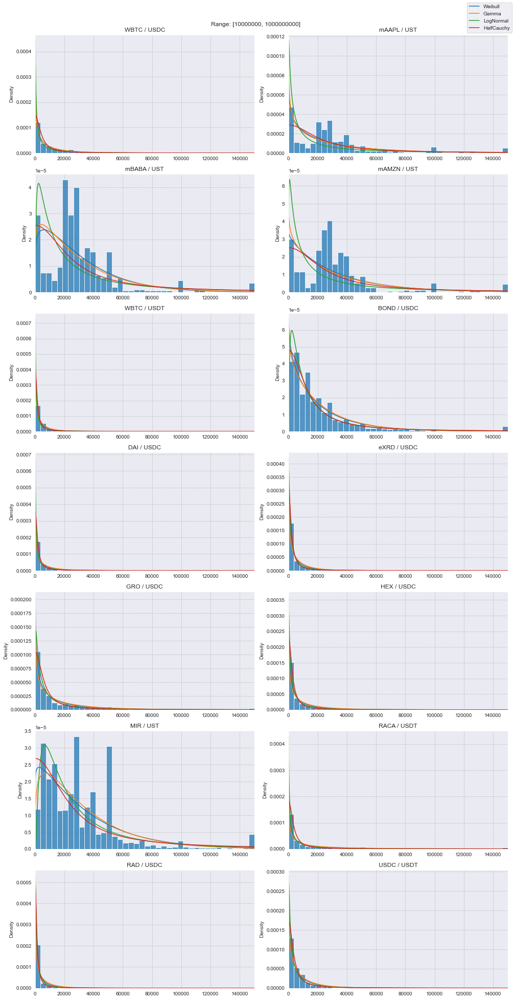

In [262]:
X_MAX_LIST = [1000, 3000, 10000, 15000, 20000, 25000, 30000, 100000, 150000]

reserve_i = 0
for a, b in zip(BOUNDARIES[:-1], BOUNDARIES[1:]):    
    print(f'Range: [{a} - {b}]')
    n_pools = get_pools_count_in_range(a, b)
    COLS = 2
    ROWS = n_pools//COLS + (n_pools % COLS != 0)

    fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*7, ROWS*4))
    ax = ax.ravel()
    
    X_MAX = X_MAX_LIST[reserve_i]
    
    i = 0
    for key, df in swaps.items():
        x_name, y_name, stable_index = POOLS[key]
        
        range_swaps_df = df[(df[f'reserve{stable_index}'] >= a) & (df[f'reserve{stable_index}'] < b)]
        range_swaps_y_df = range_swaps_df[range_swaps_df.token_in == y_name]
        amount_in_values = range_swaps_df[range_swaps_df.token_in == y_name].amount_in.values
        count = len(amount_in_values)        

        if count < MIN_SAMPLES:
            continue
            
        values = amount_in_values.copy()
        values[values > X_MAX] = X_MAX
        values = np.append(values, X_MAX)
        
        sns.histplot(data=values, bins=40,  ax=ax[i], stat='density')
        ax[i].set_title(f'{x_name} / {y_name}')
        ax[i].set_xlim(0, X_MAX)
        
        
        for j, dist in enumerate(dist_list):
            fitted_params = dist.fit(amount_in_values, method='mle', floc=0)
            loc, scale = fitted_params[-2], fitted_params[-1]
            dist_args = fitted_params[:-2]

            plot_pdf(dist(*fitted_params), dist_names[j] if i == 0 else None, X_MAX, ax[i])
        i += 1

    fig.suptitle(f'Range: [{a}, {b}]') 
    fig.tight_layout(rect=[0, 0.03, 1, 0.99])
    fig.legend()
    reserve_i += 1

Reserve range: [0 - 1000]
Reserve range: [1000 - 10000]
Reserve range: [10000 - 50000]
Reserve range: [50000 - 100000]
Reserve range: [100000 - 200000]
Reserve range: [200000 - 500000]
Reserve range: [500000 - 1000000]
Reserve range: [1000000 - 10000000]
Reserve range: [10000000 - 1000000000]


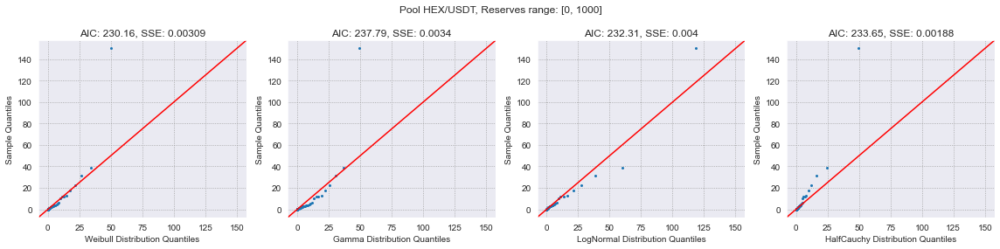

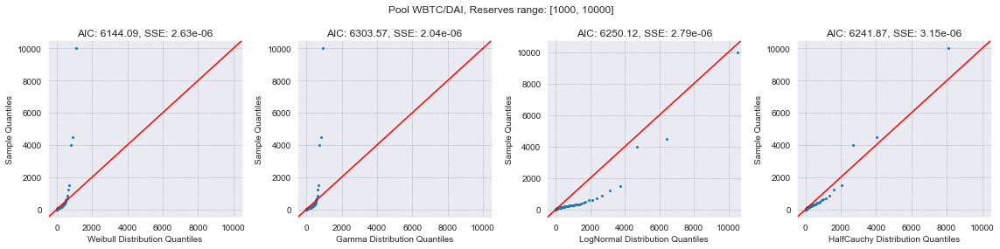

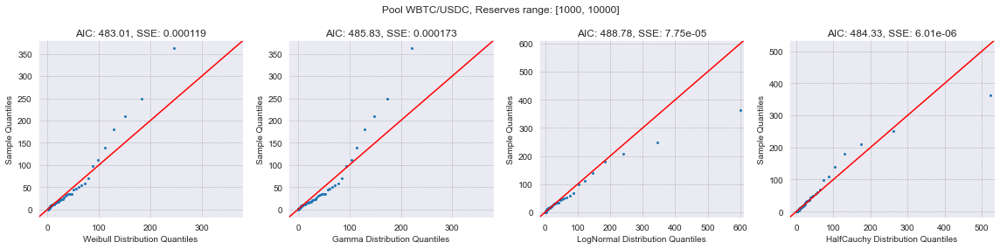

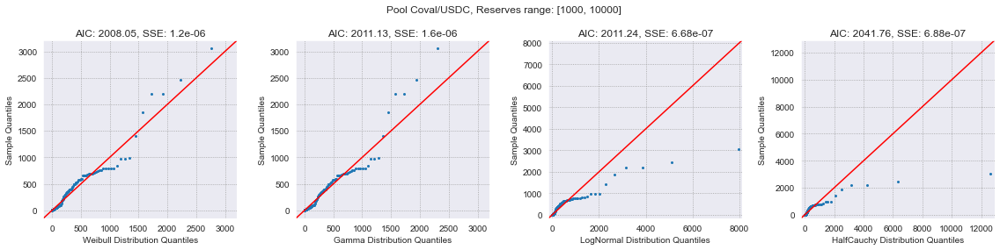

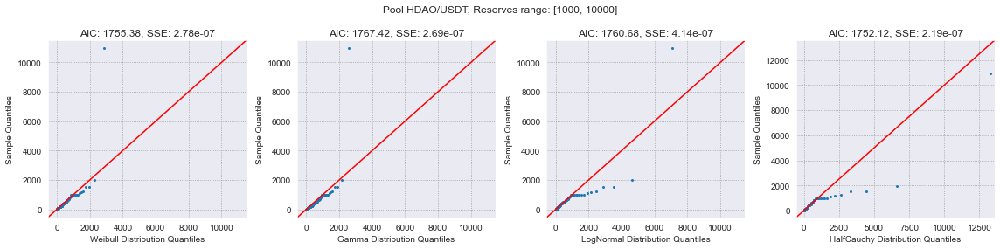

...

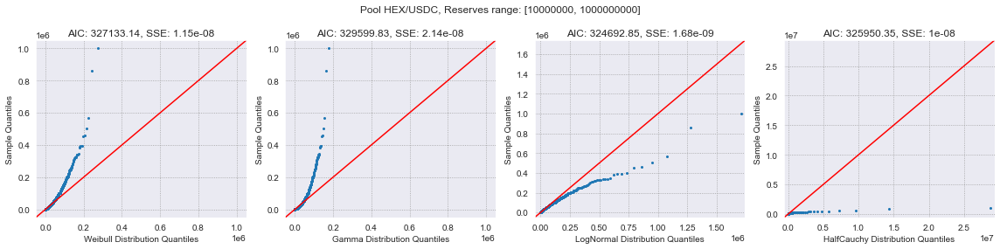

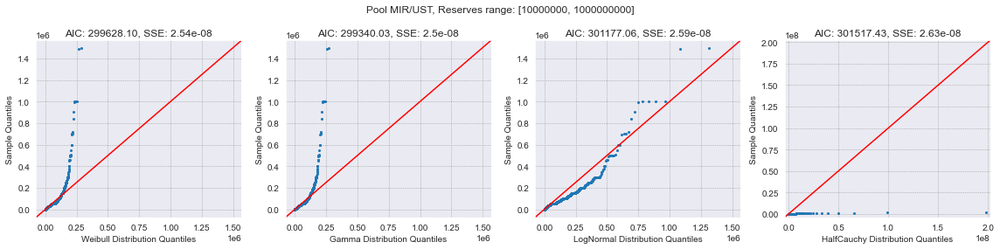

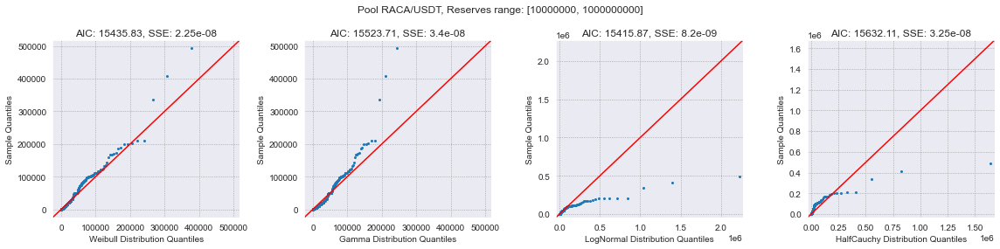

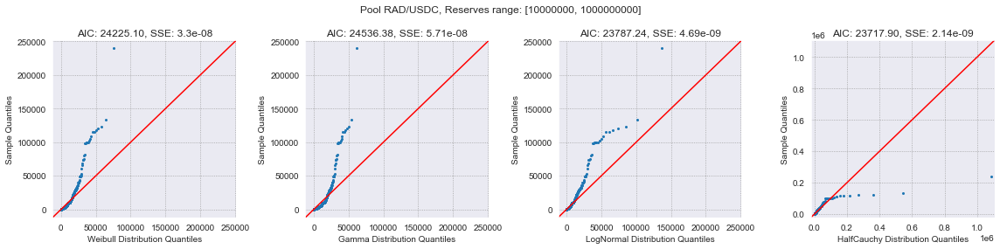

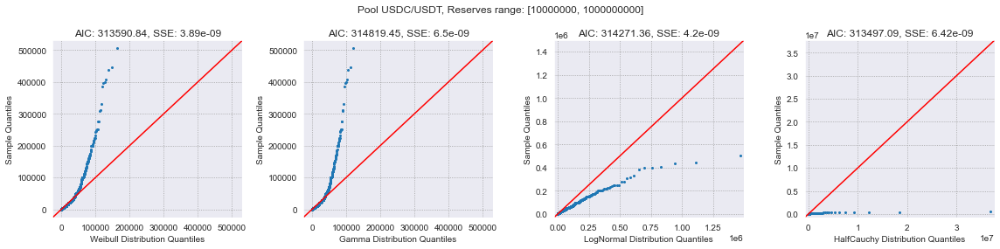

In [153]:
# Compare distributions (QQ-plot)

dist_list = [scipy.stats.weibull_min, scipy.stats.gamma, scipy.stats.lognorm, scipy.stats.halfcauchy]
dist_names = ['Weibull', 'Gamma', 'LogNormal', 'HalfCauchy']
errors_df = pd.DataFrame(columns=['pool','reserves_lower_limit','reserves_upper_limit', 'dist', 'AIC', 'SSE', 'MAE', ])

with warnings.catch_warnings():
    warnings.simplefilter('ignore')
    
    for a, b in zip(BOUNDARIES[:-1], BOUNDARIES[1:]):    
        print(f'Reserve range: [{a} - {b}]')

        for key, df in swaps.items():
            x_name, y_name, stable_index = POOLS[key]

            range_swaps_df = df[(df[f'reserve{stable_index}'] >= a) & (df[f'reserve{stable_index}'] < b)]
            range_swaps_y_df = range_swaps_df[range_swaps_df.token_in == y_name]
            amount_in_values = range_swaps_df[range_swaps_df.token_in == y_name].amount_in.values
            count = len(amount_in_values)

            shape, loc, scale = None, None, None 

            if count < MIN_SAMPLES:
                continue

            COLS = len(dist_list)
            ROWS = 1
            fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*4))
            ax = ax.ravel()

            for j, dist in enumerate(dist_list):
                fitted_params = dist.fit(amount_in_values, method='mle', floc=0)
                loc, scale = fitted_params[-2], fitted_params[-1]
                dist_args = fitted_params[:-2]

                sm.qqplot(amount_in_values, dist, distargs=dist_args, loc=loc, scale=scale, line="45", ax=ax[j], markersize=2)
                ax[j].set_xlabel(f'{dist_names[j]} Distribution Quantiles')

                sq_error, mae, AIC = compute_errors(amount_in_values, dist(*fitted_params), len(fitted_params) - 1)

                ax[j].set_title(f'AIC: {AIC:.2f}, SSE: {sq_error:.3g}')
                errors_df.loc[len(errors_df)] = [x_name + '/' + y_name, a, b, dist_names[j], AIC, sq_error, mae]

            fig.suptitle(f'Pool {x_name}/{y_name}, Reserves range: [{a}, {b}]') 

            fig.tight_layout()

In [157]:
min_errors_df = errors_df.groupby(['reserves_lower_limit', 'reserves_upper_limit', 'pool'])[['AIC', 'SSE', 'MAE']].min().add_prefix('min_').reset_index()

errors_df = errors_df.merge(min_errors_df)

errors_df.loc[:, 'AIC_score'] = 0
errors_df.loc[:, 'MAE_score'] = 0
errors_df.loc[:, 'SSE_score'] = 0
errors_df.loc[errors_df['AIC'] == errors_df['min_AIC'], 'AIC_score'] = 1
errors_df.loc[errors_df['MAE'] == errors_df['min_MAE'], 'MAE_score'] = 1
errors_df.loc[errors_df['SSE'] == errors_df['min_SSE'], 'SSE_score'] = 1

In [158]:
errors_df.groupby(['dist', 'reserves_upper_limit']).sum()

AIC         SSE        MAE     min_AIC     min_SSE    min_MAE  AIC_score  MAE_score  SSE_score
dist       reserves_upper_limit                                                                                                       
Gamma      1000                     237.792  0.00340371  0.0792183     230.159  0.00187962  0.0602441          0          0          0
           10000                    78830.4 0.000205949  0.0522767     78514.8  2.1943e-05  0.0294873          3          4          3
           50000                     191360 1.17388e-05  0.0179563      190836 9.45653e-06   0.016283          4          7          9
           100000                    184288 4.71292e-06  0.0151959      184135 3.54718e-06  0.0133192          2          3          3
           200000                    118587 1.57457e-06  0.0109045      118506 1.14245e-06 0.00984523          4          5          3
           500000                    587667  5.5034e-07 0.00718118      587265 3.90626e-07 0.00644834          9          9          8
           1000000               1.1801e+06 2.56644e-06  0.0133122 1.17911e+06 1.39253e-06  0.0113502         11         10          7
           10000000             3.56251e+06 1.22677e-06  0.0185122 3.55246e+06 5.16133e-07  0.0146685         10         10          8
           1000000000           1.73787e+06 3.45898e-07  0.0081679 1.72725e+06 1.57449e-07 0.00658318          4          3          4
HalfCauchy 1000                     233.645  0.00187962  0.0602441     230.159  0.00187962  0.0602441          0          1          1
           10000                    79487.1 3.37818e-05  0.0363441     78514.8  2.1943e-05  0.0294873          1          4          4
           50000                     192410 1.51675e-05  0.0221674      190836 9.45653e-06   0.016283          2          1          2
           100000                    185967 4.25894e-06  0.0152432      184135 3.54718e-06  0.0133192          0          4          5
           200000                    119760 2.09352e-06  0.0122519      118506 1.14245e-06 0.00984523          1          5          4
           500000                    591667 5.77882e-07 0.00809436      587265 3.90626e-07 0.00644834          0          4          5
           1000000                1.189e+06 1.85904e-06  0.0142404 1.17911e+06 1.39253e-06  0.0113502          0          4          3
           10000000             3.57576e+06 7.28552e-07  0.0182844 3.55246e+06 5.16133e-07  0.0146685          1          8          9
           1000000000           1.73407e+06 2.41631e-07 0.00755181 1.72725e+06 1.57449e-07 0.00658318          2          3          2
LogNormal  1000                     232.311  0.00400389  0.0793934     230.159  0.00187962  0.0602441          0          0          0
           10000                    80817.6 0.000144978  0.0583575     78514.8  2.1943e-05  0.0294873          0          0          1
           50000                     194192 2.08326e-05  0.0250678      190836 9.45653e-06   0.016283          1          1          1
           100000                    186192 6.20432e-06  0.0180853      184135 3.54718e-06  0.0133192          1          3          2
           200000                    119989 2.41829e-06  0.0130612      118506 1.14245e-06 0.00984523          1          2          1
           500000                    592845 7.98362e-07 0.00896295      587265 3.90626e-07 0.00644834          1          3          4
           1000000               1.1893e+06 1.60907e-06  0.0139539 1.17911e+06 1.39253e-06  0.0113502          5          7          9
           10000000             3.57159e+06 7.98261e-07  0.0171329 3.55246e+06 5.16133e-07  0.0146685          9         16         19
           1000000000           1.73307e+06 1.78434e-07 0.00698148 1.72725e+06 1.57449e-07 0.00658318          4          7          6
Weibull    1000                     230.159  0.00309344   0.070506     230.159  0.00187962  0.0602441          1          0  

### Final metric scores:

In [159]:
errors_df.groupby('dist').sum()[['AIC_score', 'MAE_score', 'SSE_score']].reset_index()

,dist,AIC_score,MAE_score,SSE_score
0,Gamma,47,51,45
1,HalfCauchy,7,34,35
2,LogNormal,22,39,43
3,Weibull,95,47,48


In [359]:
errors_df[errors_df.pool == 'WBTC/DAI'].iloc[4:12].rename(columns={'dist': 'distribution'})

,pool,reserves_lower_limit,reserves_upper_limit,distribution,AIC,SSE,MAE,min_AIC,min_SSE,min_MAE,AIC_score,MAE_score,SSE_score
48,WBTC/DAI,10000,50000,Weibull,3050.12,4.53728e-06,0.00229391,3050.12,3.60944e-06,0.00211062,1,0,0
49,WBTC/DAI,10000,50000,Gamma,3090.18,3.60944e-06,0.00211062,3050.12,3.60944e-06,0.00211062,0,1,1
50,WBTC/DAI,10000,50000,LogNormal,3105.69,6.40064e-06,0.00281513,3050.12,3.60944e-06,0.00211062,0,0,0
51,WBTC/DAI,10000,50000,HalfCauchy,3076.22,5.91532e-06,0.00260304,3050.12,3.60944e-06,0.00211062,0,0,0
108,WBTC/DAI,50000,100000,Weibull,6210.87,1.09954e-07,0.000694919,6210.87,7.93179e-08,0.000694919,1,1,0
109,WBTC/DAI,50000,100000,Gamma,6213.31,1.43639e-07,0.000755873,6210.87,7.93179e-08,0.000694919,0,0,0
110,WBTC/DAI,50000,100000,LogNormal,6348.47,2.0174e-07,0.00108028,6210.87,7.93179e-08,0.000694919,0,0,0
111,WBTC/DAI,50000,100000,HalfCauchy,6250.82,7.93179e-08,0.000710398,6210.87,7.93179e-08,0.000694919,0,0,1


### Weibull distribution
#### QQ plots visual assesment

Range: 0 - 1000
Range: 1000 - 10000
Range: 10000 - 50000
Range: 50000 - 100000
Range: 100000 - 200000
Range: 200000 - 500000
Range: 500000 - 1000000
Range: 1000000 - 10000000
Range: 10000000 - 1000000000


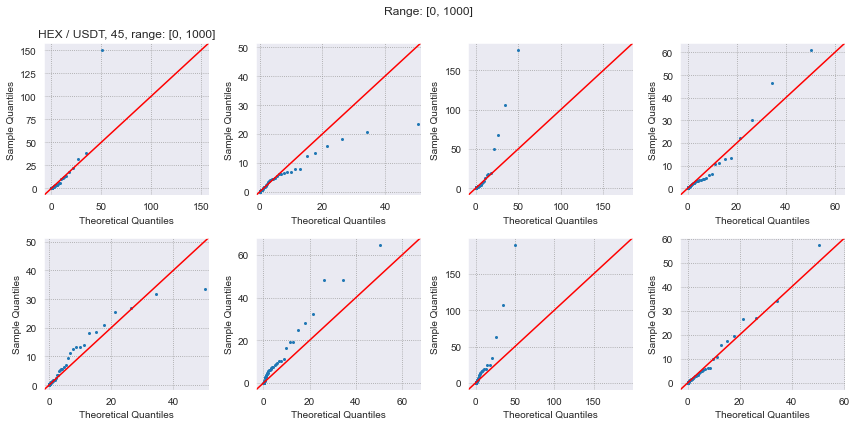

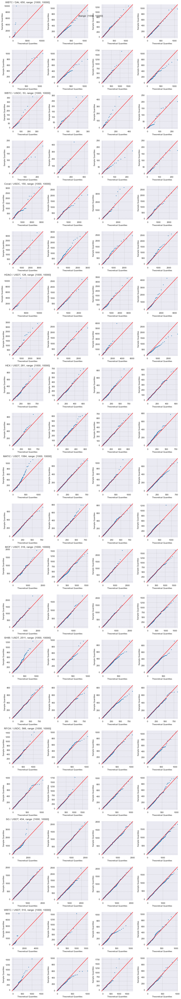

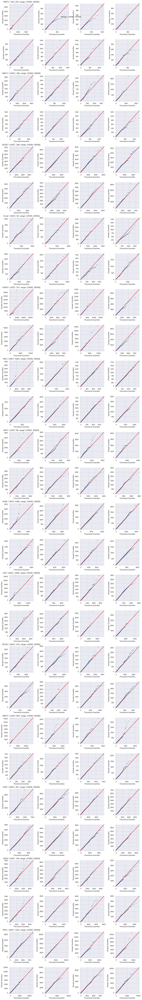

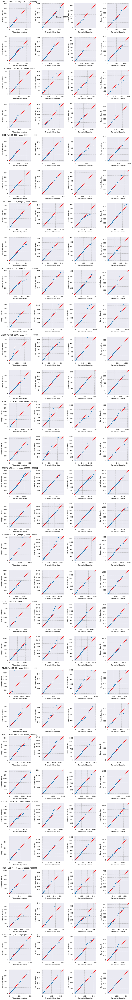

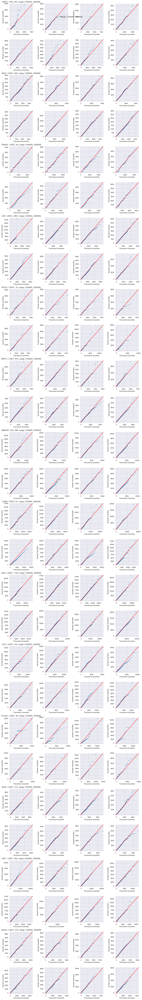

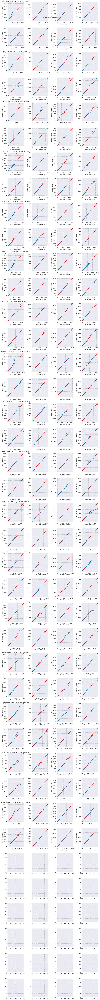

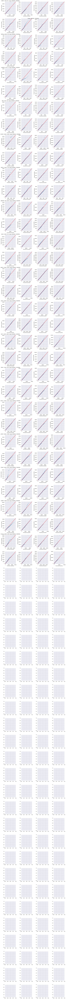

Error in callback <function flush_figures at 0x000001C2B85EF040> (for post_execute):


KeyboardInterrupt: 

In [20]:
import statsmodels.api as sm
MIN_SAMPLES = 40
total_cnt = 0

for a, b in zip(BOUNDARIES[:-1], BOUNDARIES[1:]):    
    print(f'Range: {a} - {b}')
    n_pools = get_pools_count_in_range(a, b)
    COLS = 4
    ROWS = n_pools * 2
    
    if ROWS == 0:
        continue

    fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*3, ROWS*3))
    ax = ax.ravel()
    
    i = 0
    for key, df in swaps.items():
        x_name, y_name, stable_index = POOLS[key]
        
        range_swaps_df = df[(df[f'reserve{stable_index}'] >= a) & (df[f'reserve{stable_index}'] < b)]
        range_swaps_y_df = range_swaps_df[range_swaps_df.token_in == y_name]
        amount_in_values = range_swaps_df[range_swaps_df.token_in == y_name].amount_in.values
        count = len(amount_in_values)
        total_cnt += count
        
        shape, loc, scale = None, None, None 

        if count < MIN_SAMPLES:
            continue
            
        amount_in_values = np.sort(amount_in_values)
        n_80=count
        
        shape, loc, scale = stats.weibull_min.fit(amount_in_values, method='mle', floc=0)
        sm.qqplot(amount_in_values, stats.weibull_min, distargs=(shape,), loc=loc, scale=scale, line="45", ax=ax[i*8], markersize=2)

        
        for j in range(1, 8):
            values = stats.weibull_min.rvs(shape, loc=loc, scale=scale, size=len(amount_in_values))
            sm.qqplot(values, stats.weibull_min, distargs=(shape,), loc=loc, scale=scale, line="45", ax=ax[i*8+j], markersize=2)
            
        ax[i*8].set_title(f'{x_name} / {y_name}, {count}, range: [{a}, {b}]')

        i += 1
                                           
        if i > 16:
            break
        
        break

    fig.suptitle(f'Range: [{a}, {b}]') 
    fig.tight_layout()

Range: [0 - 1000]
Range: [1000 - 10000]
Range: [10000 - 50000]
Range: [50000 - 100000]
Range: [100000 - 200000]
Range: [200000 - 500000]
Range: [500000 - 1000000]
Range: [1000000 - 10000000]
Range: [10000000 - 1000000000]


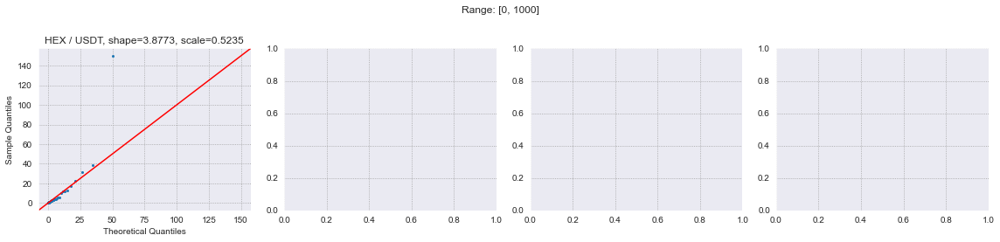

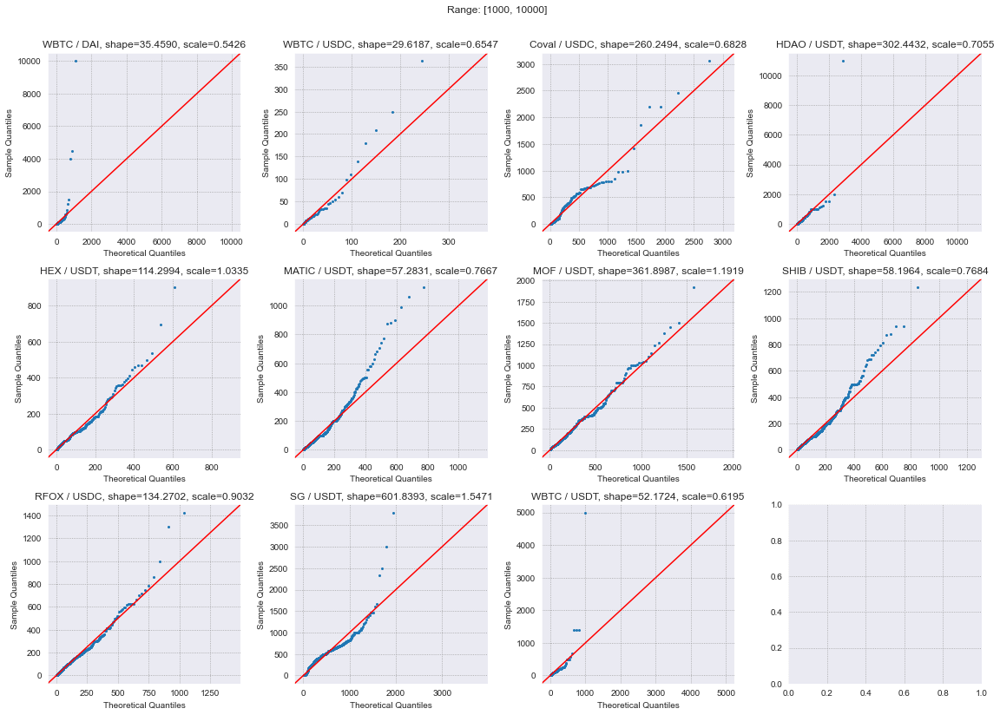

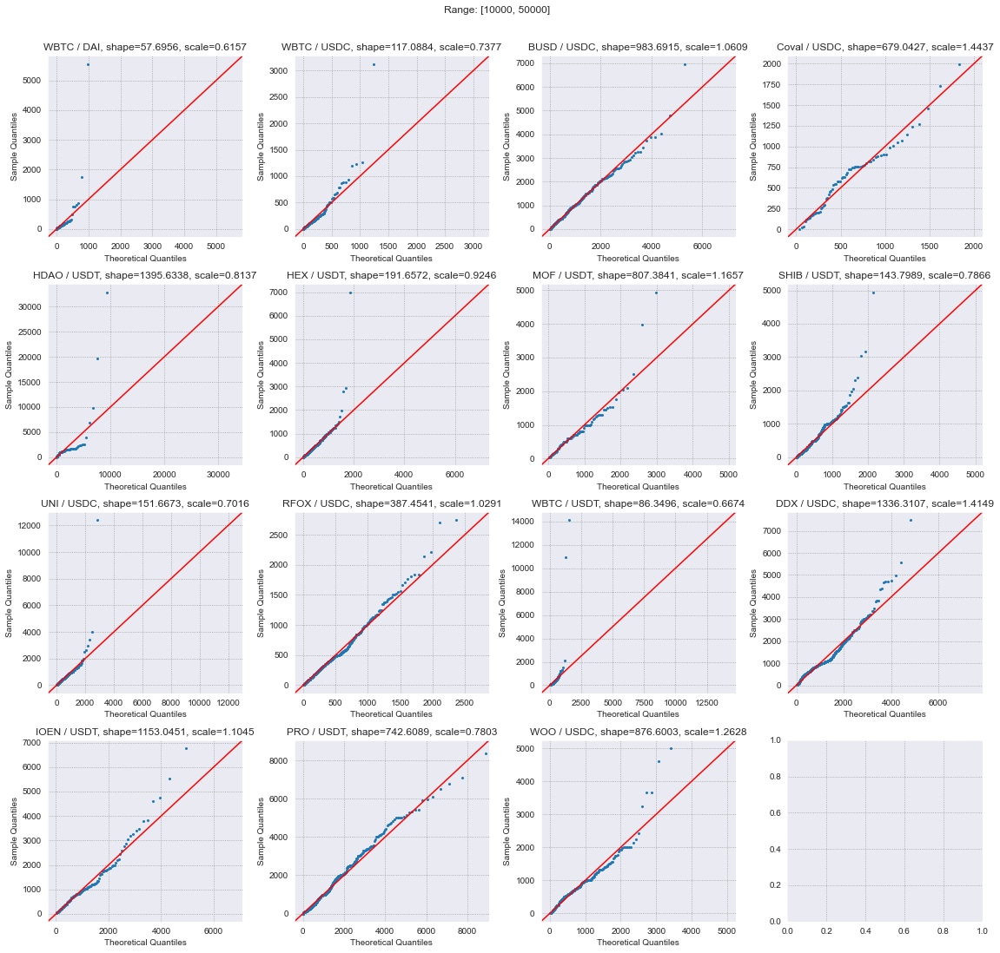

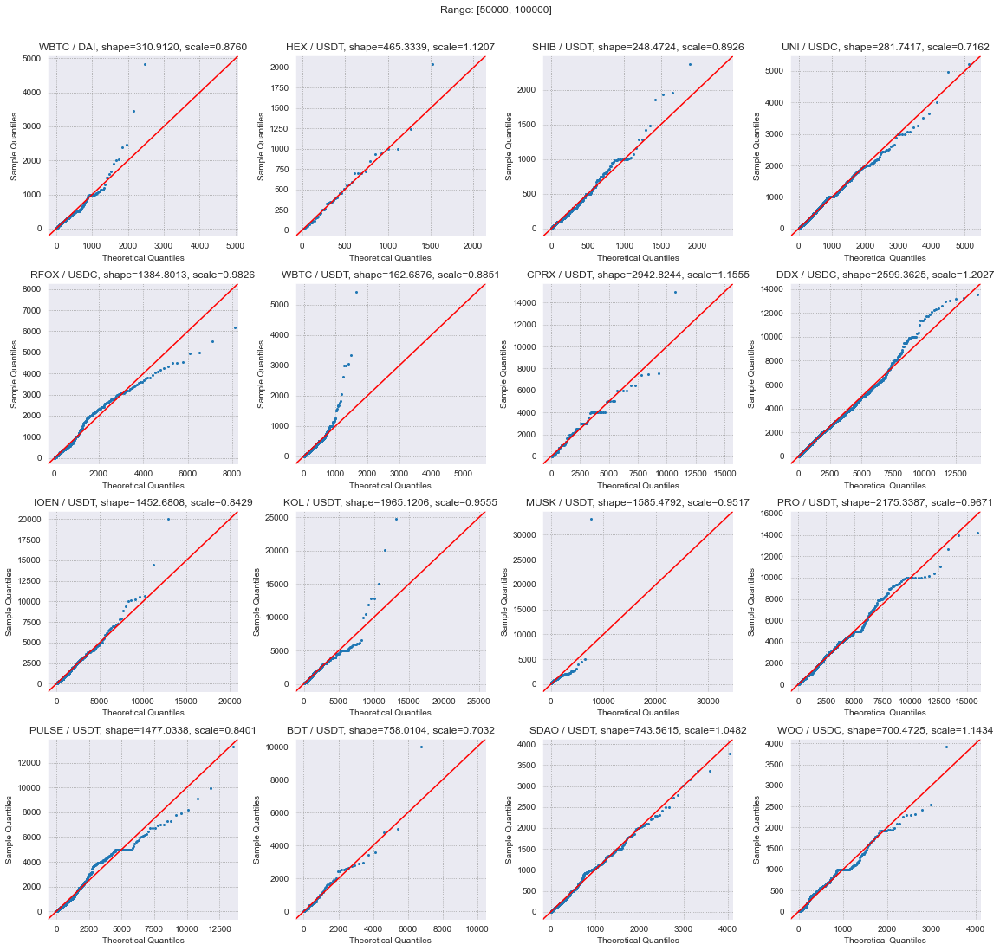

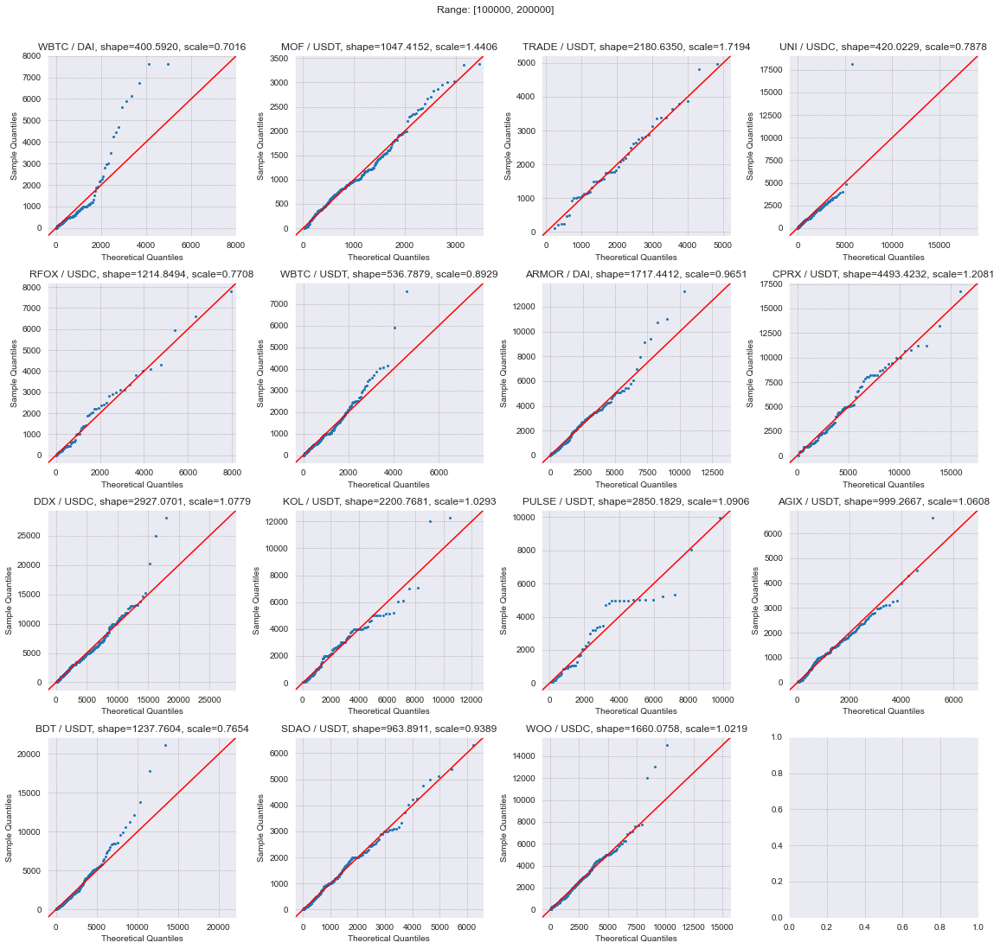

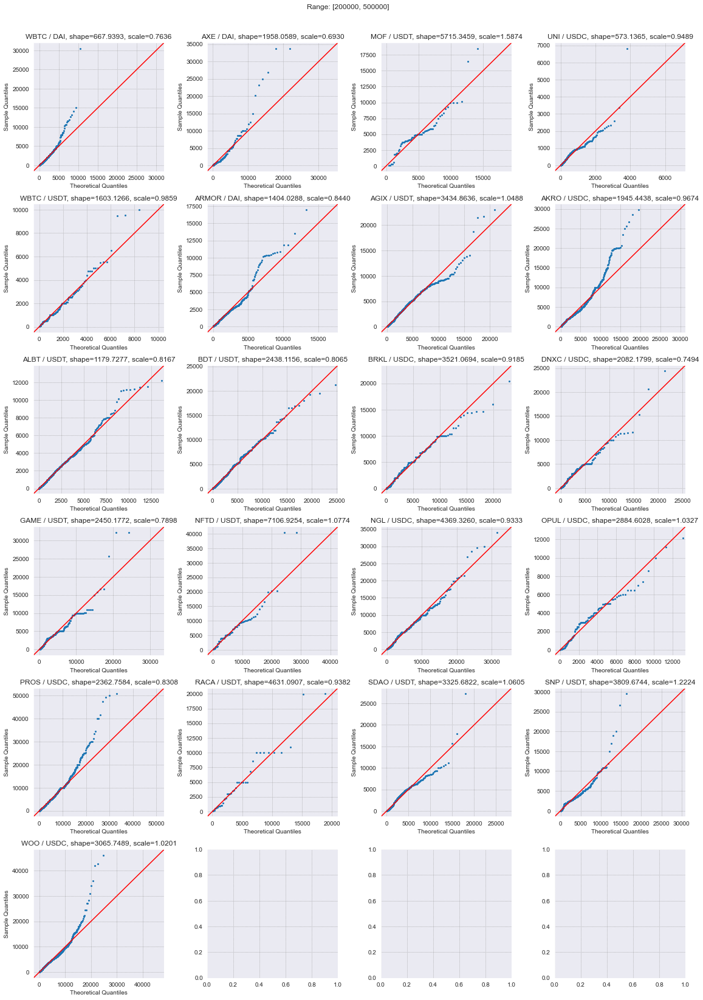

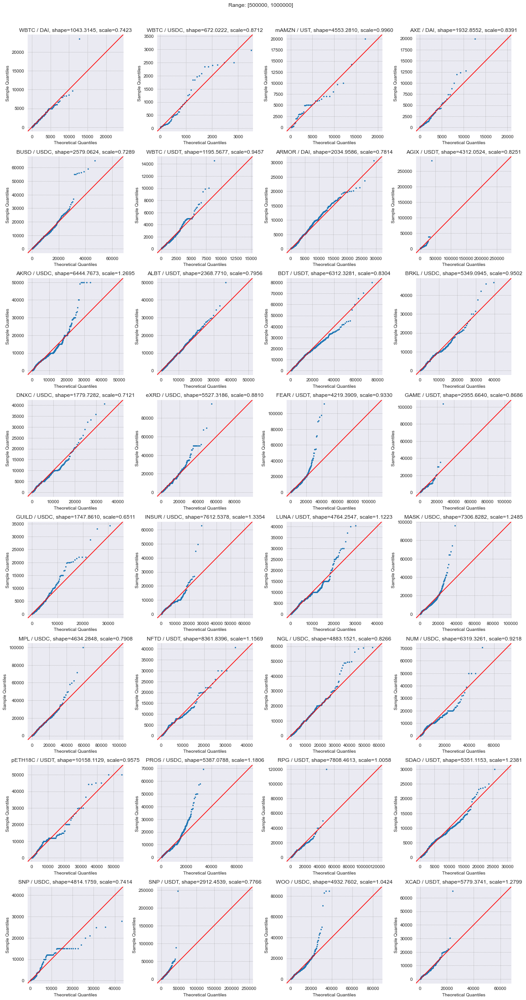

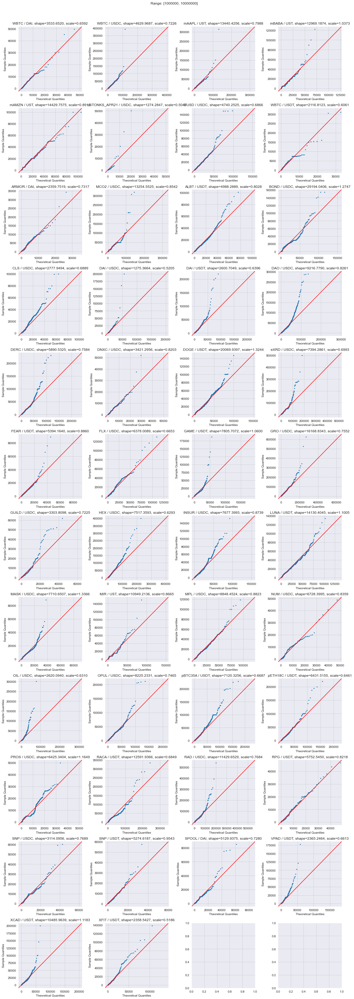

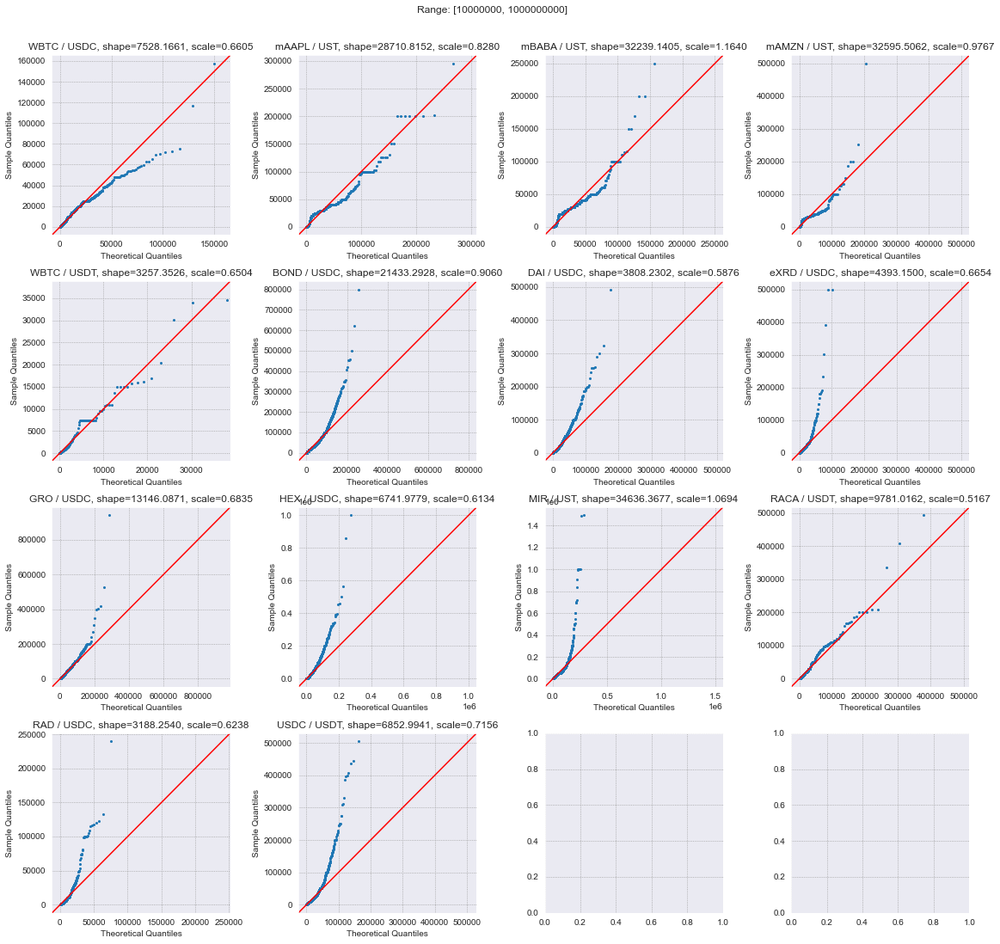

In [287]:
for a, b in zip(BOUNDARIES[:-1], BOUNDARIES[1:]):    
    print(f'Range: [{a} - {b}]')
    n_pools = get_pools_count_in_range(a, b)
    COLS = 4
    ROWS = n_pools // COLS + (n_pools % COLS != 0)
    
    if ROWS == 0:
        continue

    fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*4))
    ax = ax.ravel()
    
    i = 0
    for key, df in swaps.items():
        x_name, y_name, stable_index = POOLS[key]
        # print(x_name, y_name)
        
        range_swaps_df = df[(df[f'reserve{stable_index}'] >= a) & (df[f'reserve{stable_index}'] < b)]
        range_swaps_y_df = range_swaps_df[range_swaps_df.token_in == y_name]
        amount_in_values = range_swaps_df[range_swaps_df.token_in == y_name].amount_in.values
        count = len(amount_in_values)
        total_cnt += count
        
        shape, loc, scale = None, None, None 

        if count < MIN_SAMPLES:
            continue
            
        amount_in_values = np.sort(amount_in_values)

        shape, loc, scale = stats.weibull_min.fit(amount_in_values, method='mle', floc=0)

        sm.qqplot(amount_in_values, stats.weibull_min, distargs=(shape,), loc=loc, scale=scale, line="45", ax=ax[i], markersize=2)
        
        sq_error, mae, AIC = compute_errors(amount_in_values, stats.weibull_min(shape, loc=loc, scale=scale), 2)
        
        ax[i].set_title(f'{x_name} / {y_name}, shape={scale:.{4}f}, scale={shape:.{4}f}')

        i += 1

    fig.suptitle(f'Range: [{a}, {b}]') 
    fig.tight_layout(rect=[0, 0.03, 1, 0.97])

### Weibull Probability Plot

In [261]:
def set_size(w,h, ax=None):
    """ w, h: width, height in inches """
    if not ax: ax=plt.gca()
    l = ax.figure.subplotpars.left
    r = ax.figure.subplotpars.right
    t = ax.figure.subplotpars.top
    b = ax.figure.subplotpars.bottom
    figw = float(w)/(r-l)
    figh = float(h)/(t-b)
    ax.figure.set_size_inches(figw, figh)

Results from Fit_Weibull_2P (95% CI):
Analysis method: Maximum Likelihood Estimation (MLE)
Optimizer: TNC
Failures / Right censored: 43/0 (0% right censored) 

Parameter  Point Estimate  Standard Error  Lower CI  Upper CI
    Alpha         4.18644          1.2613   2.31949    7.5561
     Beta        0.535048       0.0598366  0.429733  0.666171 

Goodness of fit    Value
 Log-likelihood -111.554
           AICc  227.408
            BIC  230.631
             AD 0.801155 



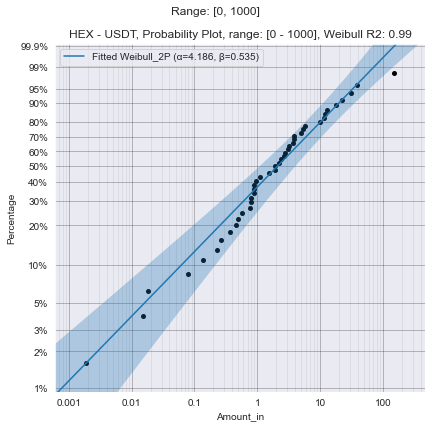

In [232]:
reserve_range_index = 0

for a, b in zip(BOUNDARIES[:-1], BOUNDARIES[1:]):   
    for key, df in swaps.items():
        x_name, y_name, stable_index = POOLS[key]
        
        range_swaps_df = df[(df[f'reserve{stable_index}'] >= a) & (df[f'reserve{stable_index}'] < b)]
        range_swaps_y_df = range_swaps_df[range_swaps_df.token_in == y_name]
        amount_in_values = range_swaps_df[range_swaps_df.token_in == y_name].amount_in.iloc[:-2]
        
        count = len(amount_in_values)
        total_cnt += count
        
        shape, loc, scale = None, None, None 

        if count < MIN_SAMPLES:
            continue

        fig, ax = plt.subplots()
        fit = Fit_Weibull_2P(failures=amount_in_values.values, downsample_scatterplot=False, method='MLE',)  # fits a Weibull distribution to the data and generates the probability plot
        R2 = compute_weibull_corr_coefficient(amount_in_values.values)
        
        plt.gca().set_xlabel(f'Amount_in')
        plt.gca().set_ylabel('Percentage')
        plt.gca().set_title(f'{x_name} - {y_name}, Probability Plot, range: [{a} - {b}], Weibull R2: {R2:.2f}')
        plt.gca()
        plt.legend()
        set_size(5,5)
            
        fig.suptitle(f'Range: [{a}, {b}]') 
        fig.tight_layout()
        
        
        
    reserve_range_index += 1
    
    # remove break to construct PP for all ranges
    break
    

In [151]:
def qq_plot_tail_deviation(sample_values, dist, tail_pct=4):    
    nobs = len(sample_values)
    
    theoretical_percentiles = np.arange(1, nobs + 1) / (nobs + 1)
    theoretical_quantiles = dist.ppf(theoretical_percentiles)
    
    sample_quantiles = np.sort(sample_values)    
    
    start_tail_idx = (100 - tail_pct) * nobs // 100
    tail_sample_quantiles = sample_quantiles[start_tail_idx:].copy()
    tail_theoretical_quantiles = theoretical_quantiles[start_tail_idx:].copy()
    
    reg = LinearRegression().fit(tail_theoretical_quantiles.reshape(-1, 1), tail_sample_quantiles)
    angle = math.atan(reg.coef_) / math.pi * 180
    
    expected_angle = 45
    angle_diff = angle - expected_angle
    
    i = len(sample_quantiles) - 1
    
    while i >= 0 and sample_quantiles[i] > theoretical_quantiles[i]:
        a = 1
        i -= 1
        
    deviation_samples_cnt = len(sample_quantiles) - 1 - i 
    
    return angle_diff, deviation_samples_cnt

### Compute Weibull distribution parameters per reserve ranges for each pool

In [320]:
import math
from tqdm import tqdm

MIN_SAMPLES = 40
total_cnt = 0

all_info = {}

dtypes = np.dtype(
    [
        ("pool", str),
        ("pool_index", int),
        ("reserve_range_lower_limit", int),
        ("reserve_range_upper_limit", int),
        ("scale", int),
        ("shape", float),
        ("SSE", float),
        ("AIC", float),
        ("MAE", float),
        ("count", float),
        ("median", float),
        ("R2_weibull", float),
        ("mean_swaps_per_day", float),
        ("max", float),
        ("qq_plot_tail_angle_diff", float),
        ("qq_plot_deviation_samples_cnt", int)
    ]
)
         

        
all_stats_df = pd.DataFrame(np.empty(0, dtype=dtypes))

for key, df in tqdm(swaps.items()):
    x_name, y_name, stable_index = POOLS[key]
    
    COLS = 3
    ROWS = N_RANGES//COLS + (N_RANGES % COLS != 0)

    #print(f'POOL {x_name} - {y_name}')
    
    for i, ab in enumerate(zip(BOUNDARIES[:-1], BOUNDARIES[1:])):
        a, b = ab
        range_swaps_df = df[(df[f'reserve{stable_index}'] >= a) & (df[f'reserve{stable_index}'] < b)]
        range_swaps_y_df = range_swaps_df[range_swaps_df.token_in == y_name]
        amount_in_values = range_swaps_df[range_swaps_df.token_in == y_name].amount_in
        count = len(amount_in_values)

        total_cnt += count
        
        days_cnt = len(range_swaps_y_df.date.unique())
        mean_swaps_per_day = None
        
        if days_cnt > 0:
            mean_swaps_per_day = count / days_cnt
        
        shape, loc, scale = None, None, None 

        if count > MIN_SAMPLES:
            amount_in_values = np.sort(amount_in_values)#[:-10]

            shape, loc, scale = stats.weibull_min.fit(amount_in_values[:-3], method='mle', floc=0)
            
            dist = stats.weibull_min(shape, loc=loc, scale=scale)
            
            SSE, MAE, AIC = compute_errors(amount_in_values, dist, fitted_params_cnt = 2)    
            qq_plot_angle_diff, qq_plot_deviation_samples_cnt = qq_plot_tail_deviation(amount_in_values[:-2], dist)
              
            all_stats_df = all_stats_df.append(pd.Series({
                'pool': x_name + '/' + y_name,
                'pool_index': key,
                'reserve_range_lower_limit': a,
                'reserve_range_upper_limit': b,
                'scale': scale,
                'shape': shape,
                'SSE': SSE,
                'AIC': AIC,
                'MAE': MAE,
                'R2_weibull': compute_weibull_corr_coefficient(amount_in_values),
                'count': len(amount_in_values),
                'median': np.median(amount_in_values),
                'mean_swaps_per_day': mean_swaps_per_day,
                'max': amount_in_values.max(),
                "qq_plot_tail_angle_diff": qq_plot_angle_diff,
                "qq_plot_deviation_samples_cnt": qq_plot_deviation_samples_cnt
            }), ignore_index=True)
                    
    fig.suptitle(f'{x_name} / {y_name}') 
    fig.tight_layout()


100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [00:46<00:00,  1.58it/s]


In [321]:
all_stats_df.sort_values(by=['R2_weibull'], ascending=True).head(10)

,pool,pool_index,reserve_range_lower_limit,reserve_range_upper_limit,scale,shape,SSE,AIC,MAE,count,median,R2_weibull,mean_swaps_per_day,max,qq_plot_tail_angle_diff,qq_plot_deviation_samples_cnt
50,SG/USDT,17,1000,10000,585.031,1.74592,5.30989e-07,6533.81,0.00176556,454,500.409,0.85379,3.49231,3794.82,23.7965,15
18,mAMZN/UST,4,10000000,1000000000,31391.1,1.06351,2.76156e-08,9473.99,0.00103955,415,27500,0.922825,2.69481,500000,13.1226,9
148,RAD/USDC,63,10000000,1000000000,3120.87,0.637727,3.14345e-08,24227.4,0.000448876,1308,1111.93,0.927035,186.857,239597,25.0735,97
15,mBABA/UST,3,10000000,1000000000,31452.9,1.23303,2.70912e-08,12072.9,0.00100202,533,27500,0.933379,3.19162,250000,16.4267,20
37,MOF/USDT,12,200000,500000,5207.28,1.91442,3.71076e-08,1256.09,0.000587961,66,4863.89,0.9379,2.12903,18527.6,-38.0511,0
123,MASK/USDC,51,500000,1000000,7256.33,1.28643,7.68086e-09,52036.1,0.000281577,2659,5246.2,0.939157,19.1295,95990.1,24.9496,102
19,uSTONKS_APR21/USDC,5,1000000,10000000,859.4,0.624429,8.90642e-08,937.726,0.000530045,55,484.081,0.93965,2.61905,50000,26.0172,11
20,AXE/DAI,6,200000,500000,1792.89,0.74323,5.51364e-08,3533.4,0.000439064,202,869.713,0.942025,22.4444,33813.2,20.1138,36
9,WBTC/USDC,1,500000,1000000,596.809,0.897349,1.76536e-06,1003.97,0.00365294,66,382.433,0.950009,66,2969.87,-37.8168,0
150,RPG/USDT,64,1000000,10000000,5530.96,0.844612,1.08004e-08,5786.03,0.000362586,297,2939.22,0.951815,24.75,46742.3,-6.98445,0


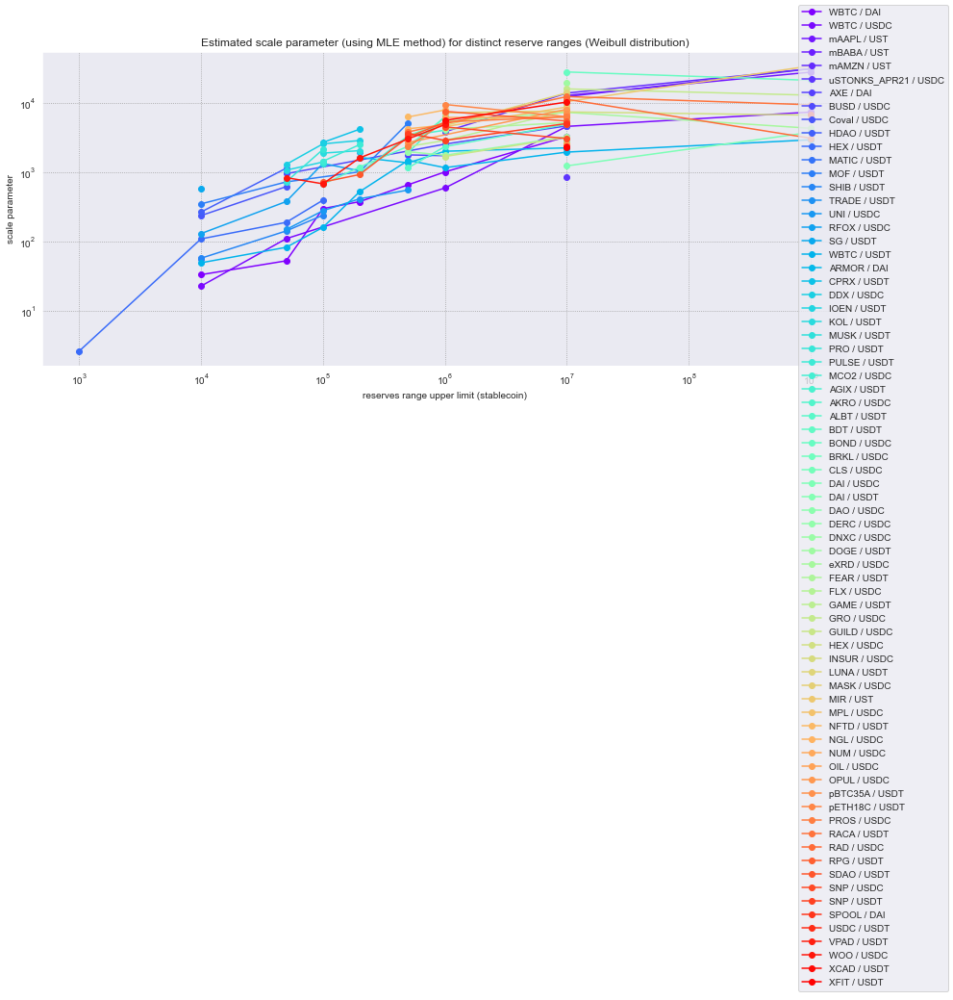

In [236]:
fig, ax = plt.subplots(figsize=(15, 6))
colors = cm.rainbow(np.linspace(0, 1, len(POOLS)))

filtered_all_stats_df = all_stats_df.copy()

for i in range(len(POOLS)):
    df = filtered_all_stats_df[filtered_all_stats_df['pool'] == (POOLS[i][0] + '/' + POOLS[i][1])]
    x = df['reserve_range_upper_limit']
    y = df['scale']
    
    if len(x) == 0:
        continue
    
    ax.plot(x, y, marker='o', label=f'{POOLS[i][0]} / {POOLS[i][1]}', color=colors[i])

ax.set_xscale('log')
ax.set_yscale('log')

ax.set_xlabel('reserves range upper limit (stablecoin)')
ax.set_ylabel('scale parameter')
ax.set_title('Estimated scale parameter (using MLE method) for distinct reserve ranges (Weibull distribution)')

fig.legend()

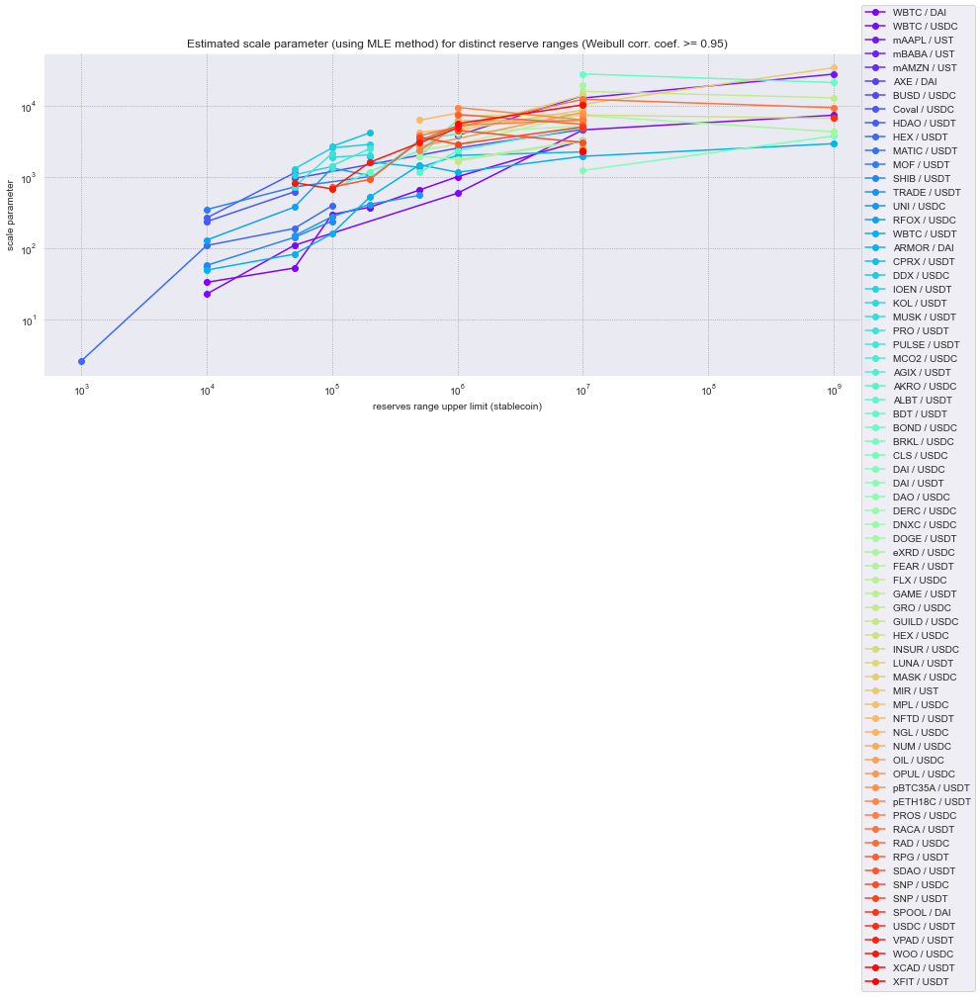

In [326]:
fig, ax = plt.subplots(figsize=(15, 6))
colors = cm.rainbow(np.linspace(0, 1, len(POOLS)))

filtered_all_stats_df = all_stats_df[all_stats_df.R2_weibull >= 0.95].copy()

for i in range(len(POOLS)):
    df = filtered_all_stats_df[filtered_all_stats_df.pool == POOLS[i][0] + '/' + POOLS[i][1]]
    x = df['reserve_range_upper_limit']
    y = df['scale']
    
    if len(x) == 0:
        continue
    
    ax.plot(x, y, marker='o', label=f'{POOLS[i][0]} / {POOLS[i][1]}', color=colors[i])

ax.set_xscale('log')
ax.set_yscale('log')

ax.set_xlabel('reserves range upper limit (stablecoin)')
ax.set_ylabel('scale parameter')
ax.set_title('Estimated scale parameter (using MLE method) for distinct reserve ranges (Weibull corr. coef. >= 0.95)')

fig.legend()

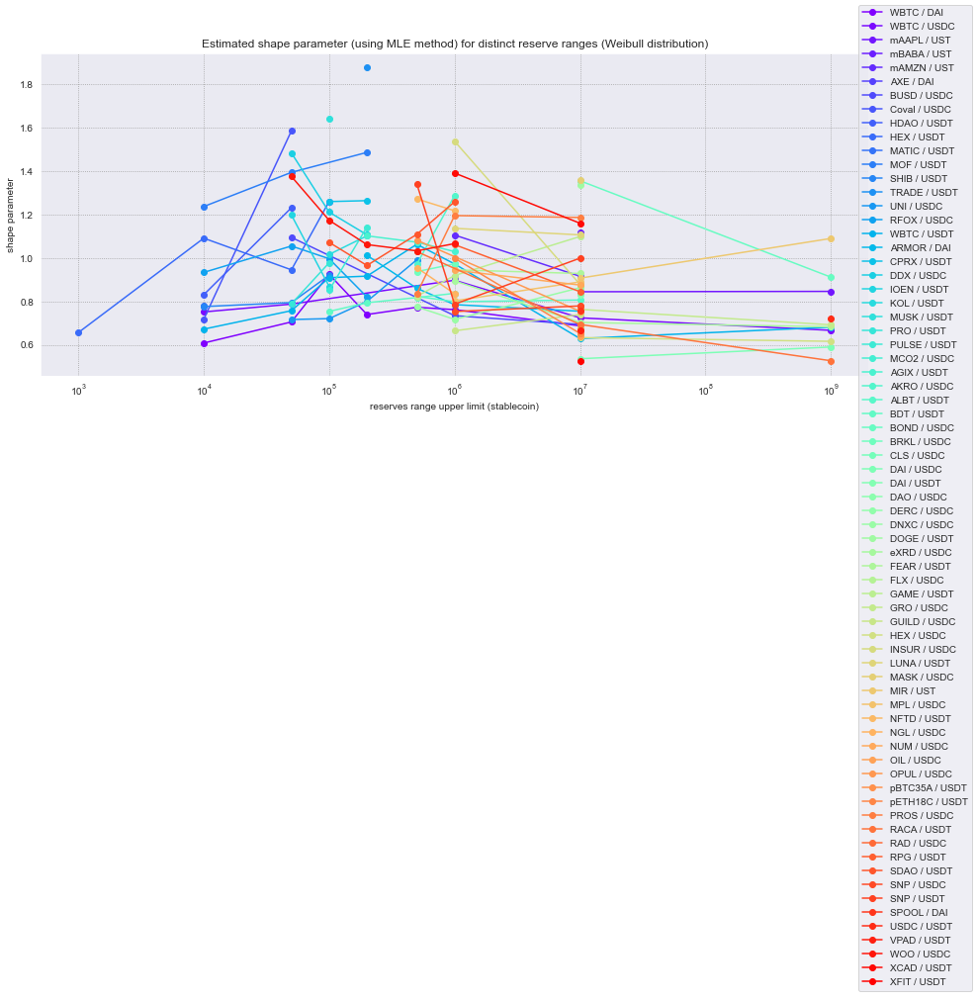

In [74]:
fig, ax = plt.subplots(figsize=(15, 6))
colors = cm.rainbow(np.linspace(0, 1, len(POOLS)))

filtered_all_stats_df = all_stats_df[all_stats_df.R2_weibull >= 0.95].copy()

for i in range(len(POOLS)):
    df = filtered_all_stats_df[filtered_all_stats_df.pool == POOLS[i][0] + '/' + POOLS[i][1]]
    x = df['reserve_range_upper_limit']
    y = df['shape']
    
    if len(x) == 0:
        continue
    
    ax.plot(x, y, marker='o', label=f'{POOLS[i][0]} / {POOLS[i][1]}', color=colors[i])

ax.set_xscale('log')

ax.set_title('Estimated shape parameter (using MLE method) for distinct reserve ranges (Weibull distribution)')
ax.set_xlabel('reserves range upper limit (stablecoin)')
ax.set_ylabel('shape parameter')

fig.legend()

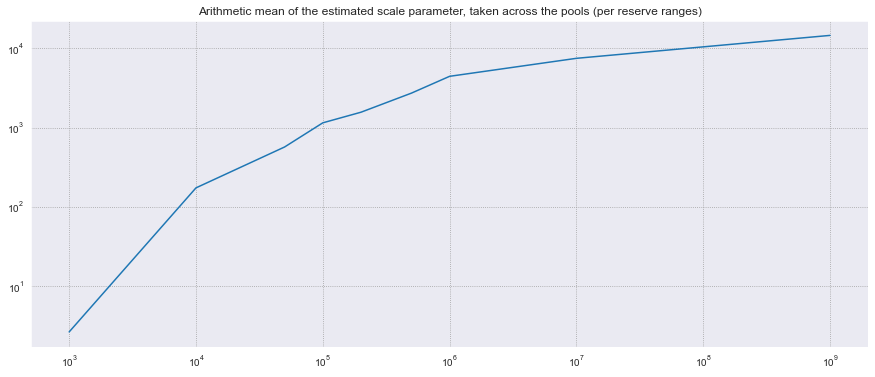

In [325]:
mean_params = all_stats_df.groupby('reserve_range_upper_limit').mean()[['scale', 'shape']]

x = mean_params.index
y = mean_params['scale']

fig, ax = plt.subplots(figsize=(15, 6))

ax.set_title('Arithmetic mean of the estimated scale parameter, taken across the pools (per reserve ranges)')
ax.set_xscale('log')
ax.set_yscale('log')
ax.plot(x, y)

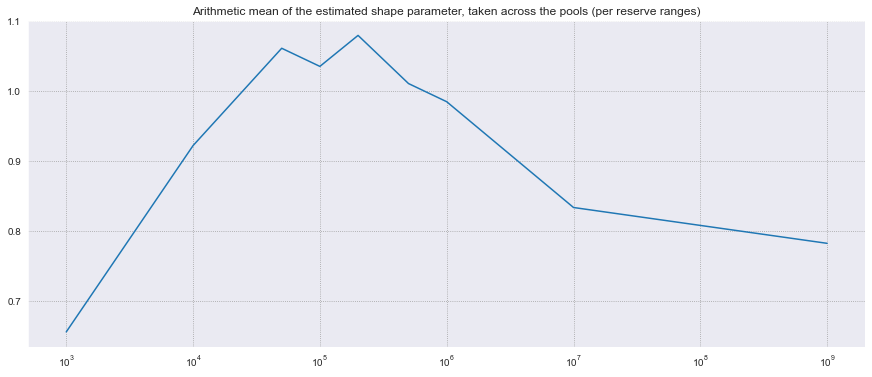

In [324]:
x = mean_params.index
y = mean_params['shape']

fig, ax = plt.subplots(figsize=(15, 6))

ax.set_title('Arithmetic mean of the estimated shape parameter, taken across the pools (per reserve ranges)')
ax.set_xscale('log')
#ax.set_yscale('log')
ax.plot(x, y)

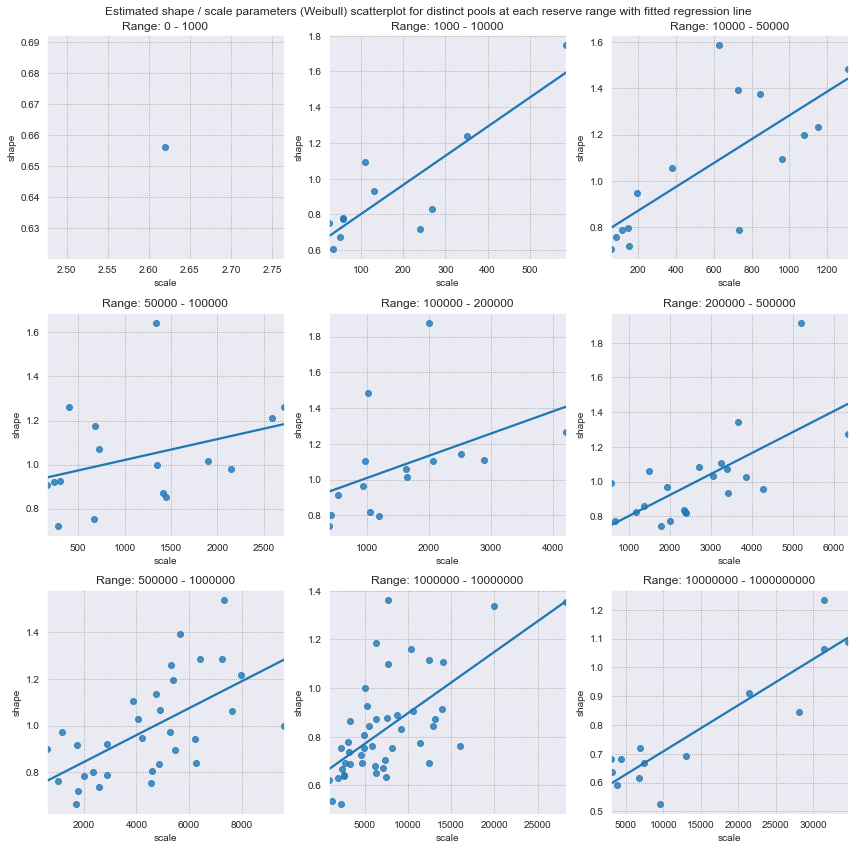

In [75]:
import math
import scipy

COLS = 3
ROWS = N_RANGES//COLS + (N_RANGES % COLS != 0)

fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*4))
ax = ax.ravel()

params = []
scale_params = []
shape_params = []


for i, ab in enumerate(zip(BOUNDARIES[:-1], BOUNDARIES[1:])):
    a, b = ab
    
    x = all_stats_df.loc[all_stats_df.reserve_range_upper_limit == b, 'scale']
    y = all_stats_df.loc[all_stats_df.reserve_range_upper_limit == b, 'shape']
    
    sns.regplot(x=x, y=y, ax=ax[i], ci=None)

    ax[i].set_title(f'Range: {BOUNDARIES[i]} - {BOUNDARIES[i + 1]}')
    ax[i].set_ylabel('shape')
    ax[i].set_xlabel('scale')
    
fig.suptitle('Estimated shape / scale parameters (Weibull) scatterplot for distinct pools at each reserve range with fitted regression line')
fig.tight_layout()

## Generalize distribution parameters

x_d 42.16264709521767
x_d 94.14391006630659
x_d 191.37230963029256
x_d 287.35897456055244
x_d 433.30943279427964
x_d 673.8751290482235
x_d 2054.1757649700517
x_d 2370.001518901926


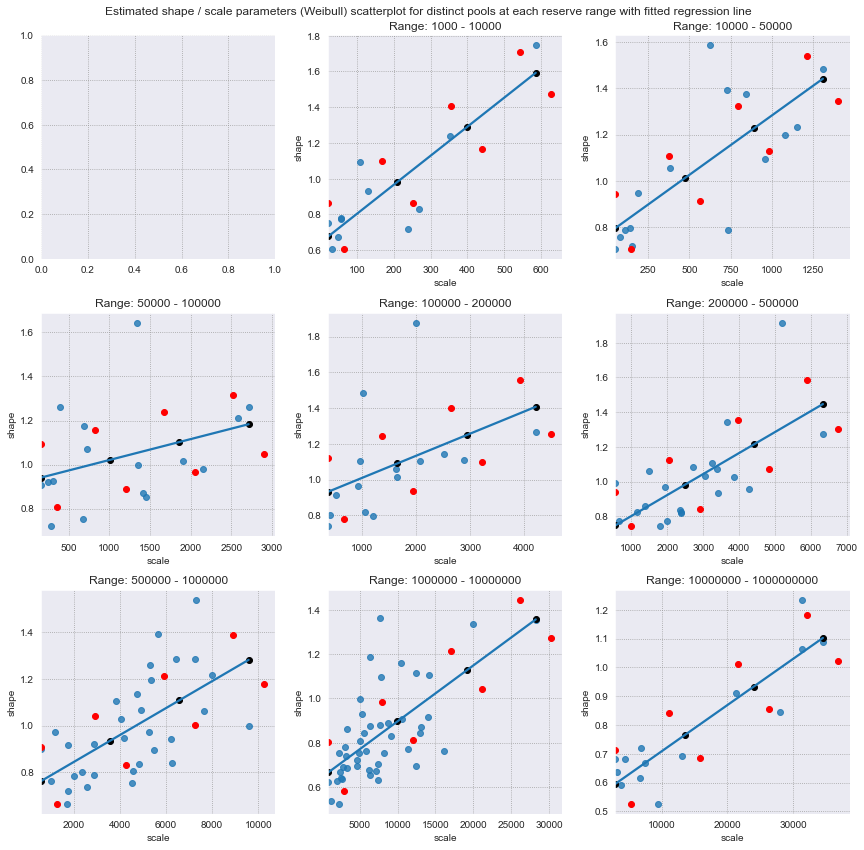

In [82]:
import math
import scipy

COLS = 3
ROWS = N_RANGES//COLS + (N_RANGES % COLS != 0)

fig, ax = plt.subplots(ROWS, COLS, figsize=(COLS*4, ROWS*4))
ax = ax.ravel()

params = []
scale_params = []
shape_params = []


for i, ab in enumerate(zip(BOUNDARIES[:-1], BOUNDARIES[1:])):
    a, b = ab
    X = all_stats_df.loc[all_stats_df.reserve_range_upper_limit == b, 'scale'].values.reshape(-1, 1)
    y = all_stats_df.loc[all_stats_df.reserve_range_upper_limit == b, 'shape'].values
    
    if len(X) < 3:
        continue

    reg = LinearRegression().fit(X, y)
    
  #  m  = reg.coef_[0]
    b = reg.intercept_
    
    f_reg = lambda x: reg.coef_[0]*x + reg.intercept_
  
    m2 = -reg.coef_[0]
    x_min = X.min()
    x_max = X.max()
    y_min = y.min()
    y_max = y.max()
    
    sns.regplot(x=X.flatten(), y=y, ax=ax[i], ci=None)

    ax[i].set_title(f'Range: {BOUNDARIES[i]} - {BOUNDARIES[i + 1]}')
    ax[i].set_ylabel('shape')
    ax[i].set_xlabel('scale')

    reserve_params = []
    reserve_scale_params = []
    reserve_shape_params = []

    ymin, ymax = ax[i].get_ylim()
    xmin, xmax = ax[i].get_xlim()
    x_range = (xmax-xmin)
    y_range = (ymax-ymin)
    
    x_d = x_range*0.075
    print('x_d', x_d)
    f_reg_above = lambda x: f_reg(x) + 0.15*y_range
    f_reg_bellow = lambda x: f_reg(x) - 0.15*y_range
    

    for x in np.linspace(x_min, x_max, 4):
        y = f_reg(x)
        
        x_bellow = x-x_d*(x != x_min)
        x_above = x+x_d
        
        y_above = f_reg_above(x_bellow)
        y_bellow = f_reg_bellow(x+x_d)
        y_bellow = max(y_bellow, y_min)
        
        b2 = y - m2*x
        
        ax[i].scatter([x], [y], color='black')
        ax[i].scatter([x_bellow], [y_above], color='red')
        ax[i].scatter([x_above], [y_bellow], color='red')

        
        reserve_scale_params.extend([x_above, x, x_bellow])
        reserve_shape_params.extend([y_bellow, y, y_above])
        
        f2 = lambda x: m2*x + b2
        
        alpha = math.atan(-m2)

        # d=5
        d = (X.max() - X.min()) *20
        delta_x = -math.sin(alpha) * d
        delta_y = math.cos(alpha) * d * y_range*y_range/x_range/x_range
                
        x11 = x + delta_x
        y11 = y + delta_y
        
        x22 = x - delta_x
        y22 = y - delta_y
        
        if x22 < 0:
            x22 = x-delta_x*0.001
            
    #params.append(reserve_params)
    scale_params.append(reserve_scale_params)
    shape_params.append(reserve_shape_params)
    
fig.suptitle('Estimated shape / scale parameters (Weibull) scatterplot for distinct pools at each reserve range with fitted regression line')
fig.tight_layout()

## Save parameters

In [ ]:
# config_list = []
# for i, reserve_range in enumerate(zip(BOUNDARIES[:-1], BOUNDARIES[1:])):
#     a, b = reserve_range

#     config = {}
#     config['reserve_range'] = [a, b]
    
#     config['scale'] = np.array(scale_params[i]).flatten().tolist()
#     config['shape'] = np.array(shape_params[i]).flatten().tolist()

#     print(a, b)
#     config_list.append(config)

In [1]:
# config_str = json.dumps(config_list)

# with open('parameters.json', 'w') as f:
#     f.write(config_str)